## Python Integration of myeloid cells 
* In the notebook will perform QC-->Integration steps following by clustering and annotation iteratively. 
* Essentially here I perform initial QC and integration on the merged object (NR_data_intersect.h5ad), I then perform clustering and exclude contaminating cells. On the remaining cells I then repeat QC-->integration steps from finidng variable genes onwards and then repeat clustering. I do this iteratively until all contaminating cells are removed and all remaining cells are annotated
* note I don't need to repeat regressing the cycling genes every iteration just in the initial QC

### Notes on the object
* I am using the intersect object and not the 'all' genes object as majority of the 'extra' genes in the all genes object are unknown, ncRNA, uncharacterised, or pseudogenes. Also by including genes only present in some datasets I worry this will cause batch specific non-biological clustering

# Set up workspace:

In [1]:
#load packages I need
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce

In [2]:
#show current directory 
os.getcwd()
os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')
os.getcwd()

'/scratch/user/s4436039/scdata/Python_Integration_Sep'

Print software versions:

In [3]:
sc.logging.print_header()

scanpy==1.10.2 anndata==0.10.8 umap==0.5.6 numpy==1.26.4 scipy==1.14.0 pandas==2.2.2 scikit-learn==1.5.0 statsmodels==0.14.2 igraph==0.11.5 pynndescent==0.5.12


In [4]:
ddl.logging.print_header()

dandelion==0.3.8 pandas==2.2.2 numpy==1.26.4 matplotlib==3.9.2 networkx==3.3 scipy==1.14.0


Set plotting parameters

In [5]:
sc.settings.set_figure_params(dpi=80, facecolor="white")

# Integration Round 1

In [9]:
#read in the file
data = sc.read_h5ad('/scratch/user/s4436039/scdata/Myeloid_Objects/NR_data_intersect.h5ad')

In [10]:
data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id'
    var: 'name'

In [11]:
data.obs

,nCount_RNA,nFeature_RNA,sample_type,cancer_type,patient_id,sample_id,percent.mt,site,sample_type_major,cancer_subtype,integration_id,ident,dataset_id
GSE215120_AM1_AAACCTGGTTGCTCCT-1,20298.000000,3789.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,0.975466,skin,primary tumour,Acral Melanoma,GSE215120_Acral_MEL_AM1,all_integrated_intersect,GSE215120
GSE215120_AM1_AAAGATGTCCAAATGC-1,5574.000000,1721.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,6.045928,skin,primary tumour,Acral Melanoma,GSE215120_Acral_MEL_AM1,all_integrated_intersect,GSE215120
GSE215120_AM1_AAAGTAGTCGGTGTTA-1,13432.000000,2759.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,2.151578,skin,primary tumour,Acral Melanoma,GSE215120_Acral_MEL_AM1,all_integrated_intersect,GSE215120
GSE215120_AM1_AAATGCCCAGAGCCAA-1,17143.000000,2659.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,1.224990,skin,primary tumour,Acral Melanoma,GSE215120_Acral_MEL_AM1,all_integrated_intersect,GSE215120
GSE215120_AM1_AAATGCCGTTTGGCGC-1,3603.000000,1012.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,3.608104,skin,primary tumour,Acral Melanoma,GSE215120_Acral_MEL_AM1,all_integrated_intersect,GSE215120
...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSE180661_HGSOC_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY_TTTCGATGTGACGTCC,-4.871771,-10.337130,Adnexa,HGSOC,Left Adnexa,SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,1541.000000,ovary,primary tumour,HGSOC,GSE180661_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,all_integrated_intersect,GSE180661
GSE180661_HGSOC_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY_TTTCGATTCTGCGAGC,-4.766977,-8.292435,Adnexa,HGSOC,Left Adnexa,SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,2596.000000,ovary,primary tumour,HGSOC,GSE180661_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,all_integrated_intersect,GSE180661
GSE180661_HGSOC_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY_TTTGATCGTTGCTCCT,-4.133310,-8.758132,Adnexa,HGSOC,Left Adnexa,SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,1200.000000,ovary,primary tumour,HGSOC,GSE180661_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,all_integrated_intersect,GSE180661
GSE180661_HGSOC_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY_TTTGGAGGTACGACAG,-9.313746,-7.889039,Adnexa,HGSOC,Left Adnexa,SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,3165.000000,ovary,primary tumour,HGSOC,GSE180661_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,all_integrated_intersect,GSE180661


In [12]:
data.var

,name
FAM87B,FAM87B
LINC00115,LINC00115
FAM41C,FAM41C
SAMD11,SAMD11
NOC2L,NOC2L
...,...
MT-ND4L,MT-ND4L
MT-ND4,MT-ND4
MT-ND5,MT-ND5
MT-ND6,MT-ND6


In [13]:
#tabulate number of cells per sample type/ site/ cancer type and export as csv
table1 = pd.crosstab(data.obs["dataset_id"], data.obs["cancer_subtype"])
table2 = pd.crosstab(data.obs["cancer_subtype"], data.obs["sample_type_major"])
table3 = pd.crosstab(data.obs["site"], data.obs["sample_type_major"])
table4 = pd.crosstab(data.obs["cancer_subtype"], data.obs["site"])


table1.to_csv('table_dataset-v-cancer_subtype.csv')
table2.to_csv('table_cancer_subtype-v-sample_type.csv')
table3.to_csv('table_site-v-sample_type.csv')
table4.to_csv('table_cancer_subtype-v-site.csv')

## Perform QC Steps on initial object:

In [14]:
# mitochondrial genes, "MT-" for human, "Mt-" for mouse
data.var["mt"] = data.var_names.str.startswith("MT-")

In [15]:
#calculate QC metrics
sc.pp.calculate_qc_metrics(
    data, qc_vars=["mt"], inplace=True, log1p=True
)

In [16]:
data.obs.columns.tolist()

['nCount_RNA',
 'nFeature_RNA',
 'sample_type',
 'cancer_type',
 'patient_id',
 'sample_id',
 'percent.mt',
 'site',
 'sample_type_major',
 'cancer_subtype',
 'integration_id',
 'ident',
 'dataset_id',
 'n_genes_by_counts',
 'log1p_n_genes_by_counts',
 'total_counts',
 'log1p_total_counts',
 'pct_counts_in_top_50_genes',
 'pct_counts_in_top_100_genes',
 'pct_counts_in_top_200_genes',
 'pct_counts_in_top_500_genes',
 'total_counts_mt',
 'log1p_total_counts_mt',
 'pct_counts_mt']

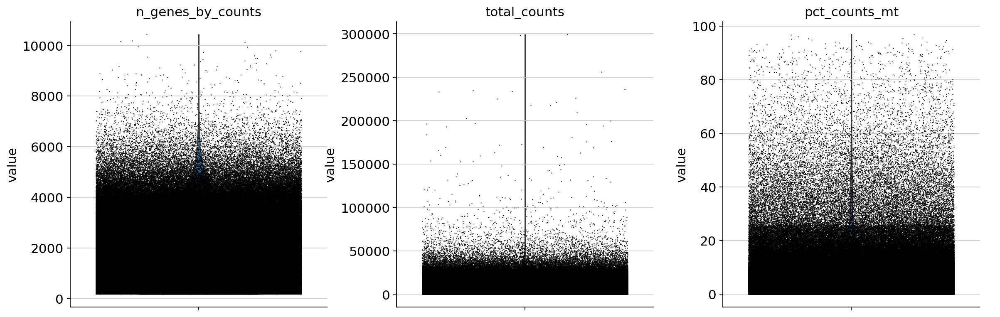

In [17]:
#plot metrics
sc.pl.violin(
    data,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

### Calculate cycling scores:
* following the method described here: https://notebook.community/theislab/scanpy_usage/180209_cell_cycle/cell_cycle

In [18]:
#load cell cycle genes previously defined in literature (Tirosh et al 2015)
cell_cycle_genes = [x.strip() for x in open('regev_lab_cell_cycle_genes.txt')]

In [19]:
# define two lists, genes associated to the S phase and genes associated to the G2M phase
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in data.var_names]

## Normalise data:

In [20]:
sc.pp.normalize_total(data, target_sum=1e4)

# Logarithmize the data:
sc.pp.log1p(data)

# check the object
data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

### save a version of the object here, this will be used for iterative annotating  
* this object will also be the one used for WGCNA (after log transform but before scaling, will need to feed the metadata (cell annotations) into this object once I have those though) 

In [21]:
#write out the object (7min)
data.write_h5ad("NRdata_pre-hvg.h5ad", compression="gzip")

## Identify hvg, regress, scaling, pca:
* from here onwards is what will be repeated after each round of clustering

In [22]:
#data = sc.read_h5ad("NRdata_pre-hvg.h5ad")
data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

### Identify highly variable genes:

In [23]:
# (Expects logarithimised data)
sc.pp.highly_variable_genes(data, min_mean=0.0125, max_mean=3, min_disp=0.5)
data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [24]:
#set hidden slot
data.raw = data

In [25]:
#to get number of HV genes
print(data.var.highly_variable.sum())

1634


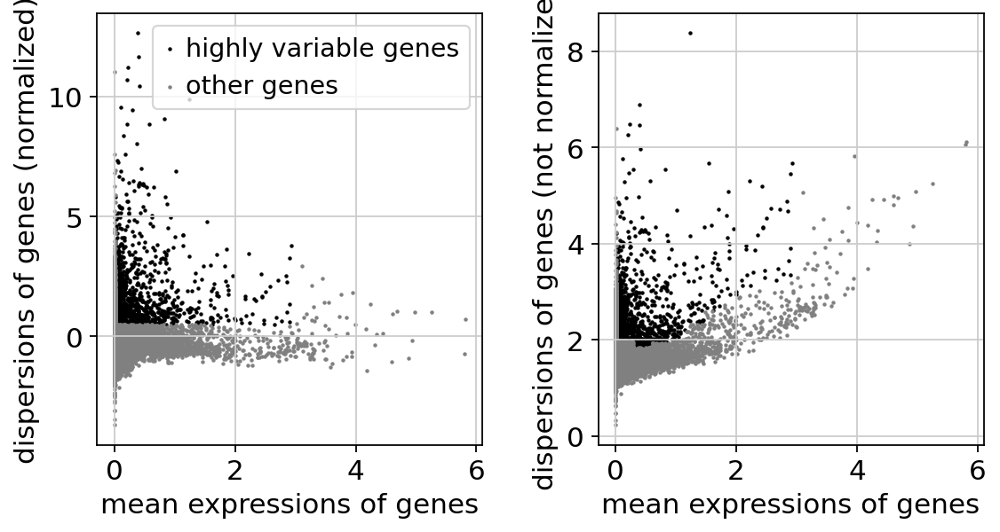

In [26]:
#plot out the number of highly variable genes
sc.pl.highly_variable_genes(data)

### Regress out necessary factors and perform scaling:

In [27]:
# Actually do the filtering for PCA
data = data[
    :, data.var.highly_variable
].copy()  # all rows/indexes : columns only selecting for those within high_variable, and then making a copy of itself
data

AnnData object with n_obs × n_vars = 623908 × 1634
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [28]:
#make a copy to perform first regression/scaling on
data1 = data.copy()

In [29]:
#regress out effects of total_counts per cell and % of mt genes (~12min)
sc.pp.regress_out(data1, ["total_counts", "pct_counts_mt"])

In [30]:
# Scale each gene to unit variance. Clip values exceeding std of 10.
sc.pp.scale(data1, max_value=10)

#### Calculate cell cycling scores for each cell:
* Note: on iterative analysis this step can be skipped

In [31]:
#cell cycle scoring, this adds three slots in data, a score for S phase, a score for G2M phase and the predicted cell cycle phase.
sc.tl.score_genes_cell_cycle(data1, s_genes=s_genes, g2m_genes=g2m_genes)

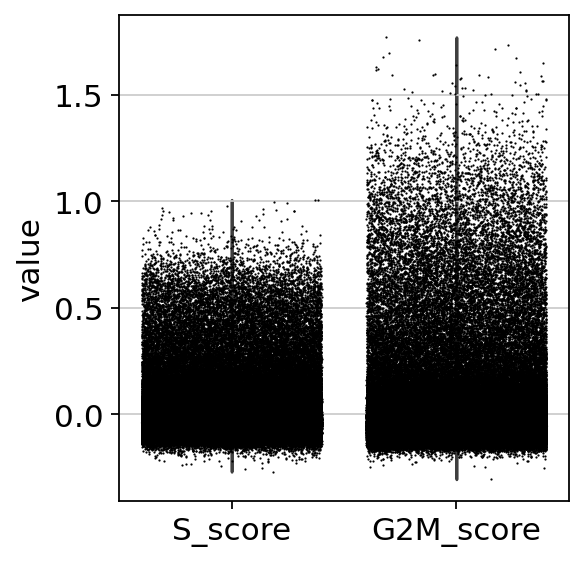

In [32]:
sc.pl.violin(data1, ['S_score', 'G2M_score'],
             jitter=0.4)

In [33]:
data.obs["S_score"] = data1.obs["S_score"]
data.obs["G2M_score"] = data1.obs["G2M_score"]

In [34]:
#save these scores to the object I'll be using for iterative analysis so that I don't need to recalculate each time
pre_hvg_data = sc.read_h5ad("NRdata_pre-hvg.h5ad")
pre_hvg_data.obs["S_score"] = data1.obs["S_score"]
pre_hvg_data.obs["G2M_score"] = data1.obs["G2M_score"]
pre_hvg_data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [35]:
pre_hvg_data.write_h5ad("NRdata_pre-hvg.h5ad", compression = "gzip")

#### Do regression: 

In [36]:
#Regress out cycling genes (15min)
sc.pp.regress_out(data, ["total_counts", "pct_counts_mt", 'S_score', 'G2M_score'])
sc.pp.scale(data, max_value=10)

In [37]:
data

AnnData object with n_obs × n_vars = 623908 × 1634
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

### Perform PCA: 

* note originally I tried increases the number of PCs a lot (>100) but this made the integration later on converge really fast and then not be well integrated, likely because increasing PCs too much can increase noise or lead to overfitting of batch effects, therefore decreased to 60

In [38]:
## perform PCA, adjust number of PCs to calculate from default (50) to 60. (3mins)
sc.tl.pca(data, n_comps=60)

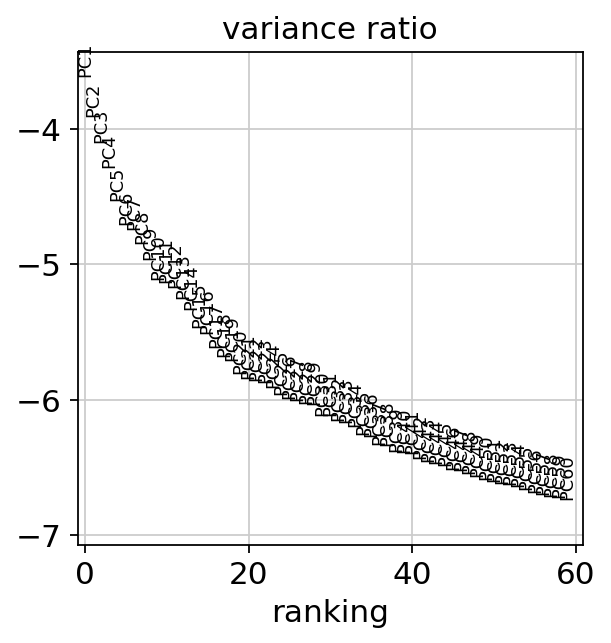

In [39]:
# make elbow plot to see variance contribution by each pc, choose inflection point
sc.pl.pca_variance_ratio(data, log=True, n_pcs=60)

#based on graph choose to use 60 PCs going forward

### Export out the object that will be used for integration:

In [40]:
#at this point export out the object as the one we will use for integration (11min)
data.write_h5ad("NRdata_pre-int.h5ad", compression="gzip")

### Perform neigborhood and UMAP on unintegrated data as a comparison:

### Neighborhood graph:

In [41]:
## Computing neighbourhood graph - here UMAP (3min)
sc.pp.neighbors(data, n_neighbors=10, n_pcs=60)

### UMAP (~10min):

In [42]:
#Embedding the neighbourhood graph using UMAP 
sc.tl.umap(data, min_dist=0.3)  # 0.3 is personal preference

### UMAP Visualisation:

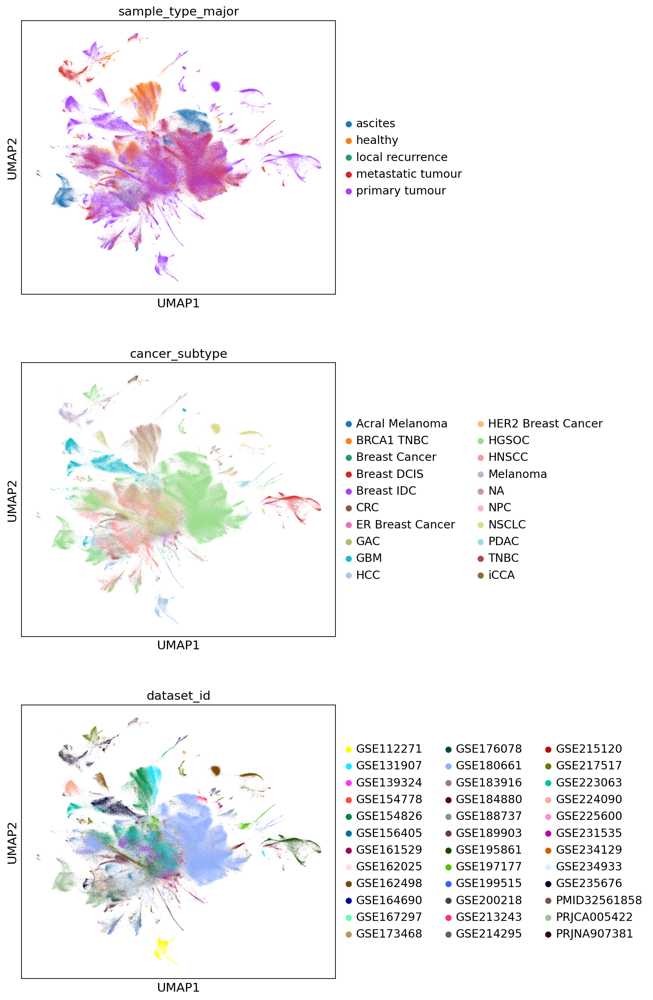

In [43]:
#visualise UMAP
with plt.rc_context({"figure.figsize": (6, 6)}):
    sc.pl.umap(
        data,
        color=[
            "sample_type_major",
            "cancer_subtype",
            "dataset_id",
        ],
        ncols=1,
    )

In [44]:
#write out the unintegrated object to be read in later if needed (12min)
data.write_h5ad("NRdata_unintegrated.h5ad", compression="gzip")

## Integration: 
#### want to perform integration after running PCA but before computing neighbor graph (perform on NRdata_pre-int.h5ad)

### Integration step was done by submitting a job. 

* Bashscript is named: _NR_bashscript-harmony-int.sh
* python script named: _NR-script-harmony-int.py

Ran with `sbatch _NR_bashscript-harmony-int.sh`

Bashscript: 
``` bash
#!/bin/bash
#SBATCH --nodes=1
#SBATCH --ntasks-per-node=1
#SBATCH --cpus-per-task=64
#SBATCH --mem=400G
#SBATCH --job-name=NR-Integration1
#SBATCH --time=18:00:00
#SBATCH --partition=general
#SBATCH --account=a_kelvin_tuong
#SBATCH -o NR-Integration1.output
#SBATCH -e NR-Integration1.error

# export JAVA_CMD=/home/uqztuong/miniforge3/bin/java
source ~/.bashrc
mamba activate env
python3 _NR-script-harmony-int.py
```

Python script: 
``` python
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce

os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')

data_pre = sc.read_h5ad('/scratch/user/s4436039/scdata/Python_Integration_Sep/NRdata_pre-int.h5ad')

sce.pp.harmony_integrate(data_pre, 'integration_id', max_iter_harmony=200, verbose=True)

data_pre.write_h5ad("/scratch/user/s4436039/scdata/Python_Integration_Sep/NRdata_post-int.h5ad", compression="gzip")
```

### Converged after 9 iterations

## Read in data after integration:

In [6]:
#read in after integration
data = sc.read_h5ad('NRdata_post-int.h5ad')

In [7]:
data.obsm

AxisArrays with keys: X_pca, X_pca_harmony

In [8]:
#check it made new column with adjusted harmony PCs
'X_pca_harmony' in data.obsm

True

In [9]:
#assign the new PCs to the standard PCA slot
data.obsm['X_pca'] = data.obsm['X_pca_harmony']

### Neighborhood graph:

In [10]:
## Computing neighbourhood graph - here UMAP
sc.pp.neighbors(data, n_neighbors=10, n_pcs=60)

### UMAP (~10min):

In [11]:
sc.tl.umap(data, min_dist=0.3)  # 0.3 is personal preference

### UMAP Visualisation:

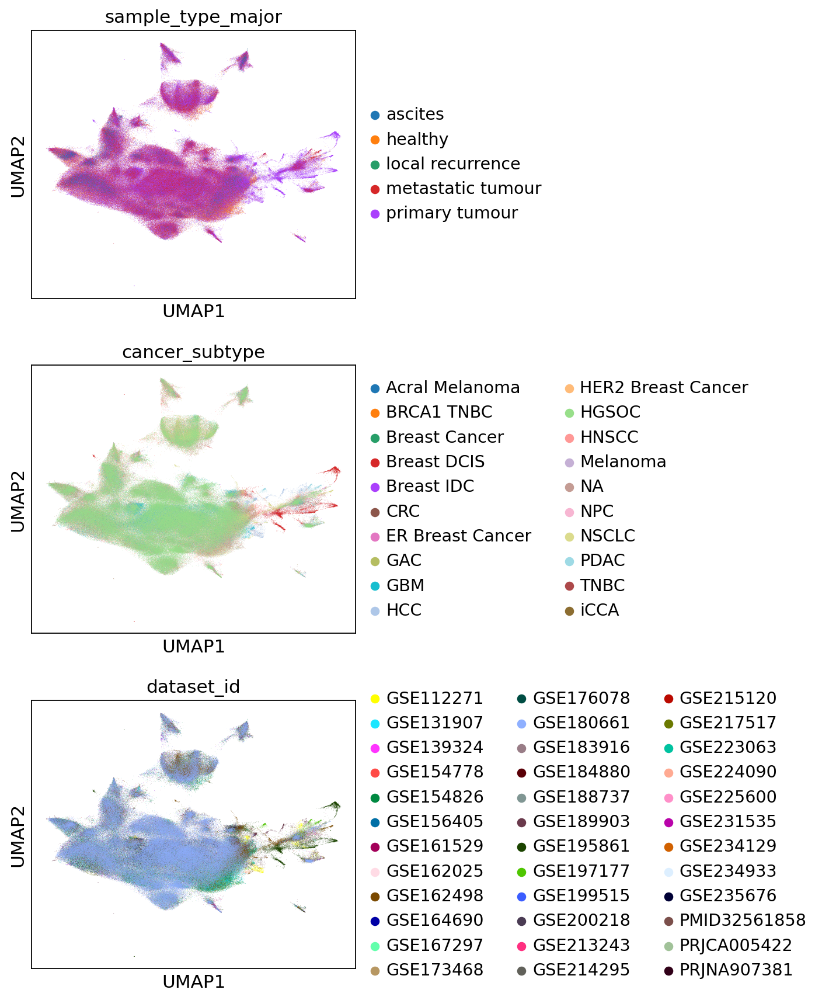

In [12]:
#same as above 
#visualise UMAP --> can see now integrated
sc.pl.umap(
    data,
    color=[
        "sample_type_major",
        "cancer_subtype",
        "dataset_id",
    ],
    ncols=1,
)

In [13]:
#split plot by sample_type_major, cancer_subtype etc

#define function
def cluster_small_multiples(
    data_int, clust_key, size=30, frameon=False, legend_loc=None, **kwargs
):
    tmp = data_int.copy()

    for i, clust in enumerate(data_int.obs[clust_key].cat.categories):
        tmp.obs[clust] = data_int.obs[clust_key].isin([clust]).astype("category")
        tmp.uns[clust + "_colors"] = ["#d3d3d3", data_int.uns[clust_key + "_colors"][i]]

    sc.pl.umap(
        tmp,
        groups=tmp.obs[clust].cat.categories[1:].values,
        color=data_int.obs[clust_key].cat.categories.tolist(),
        size=size,
        frameon=frameon,
        legend_loc=legend_loc,
        **kwargs
    )

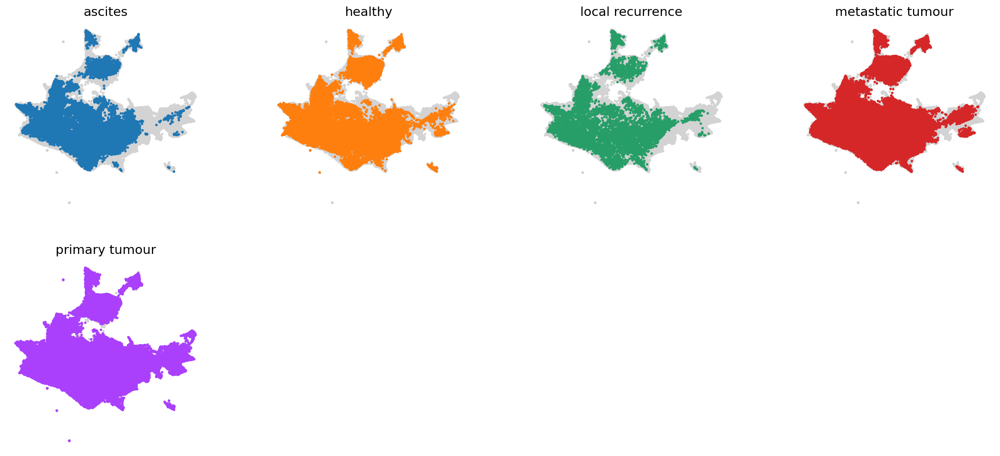

In [14]:
cluster_small_multiples(data, "sample_type_major")

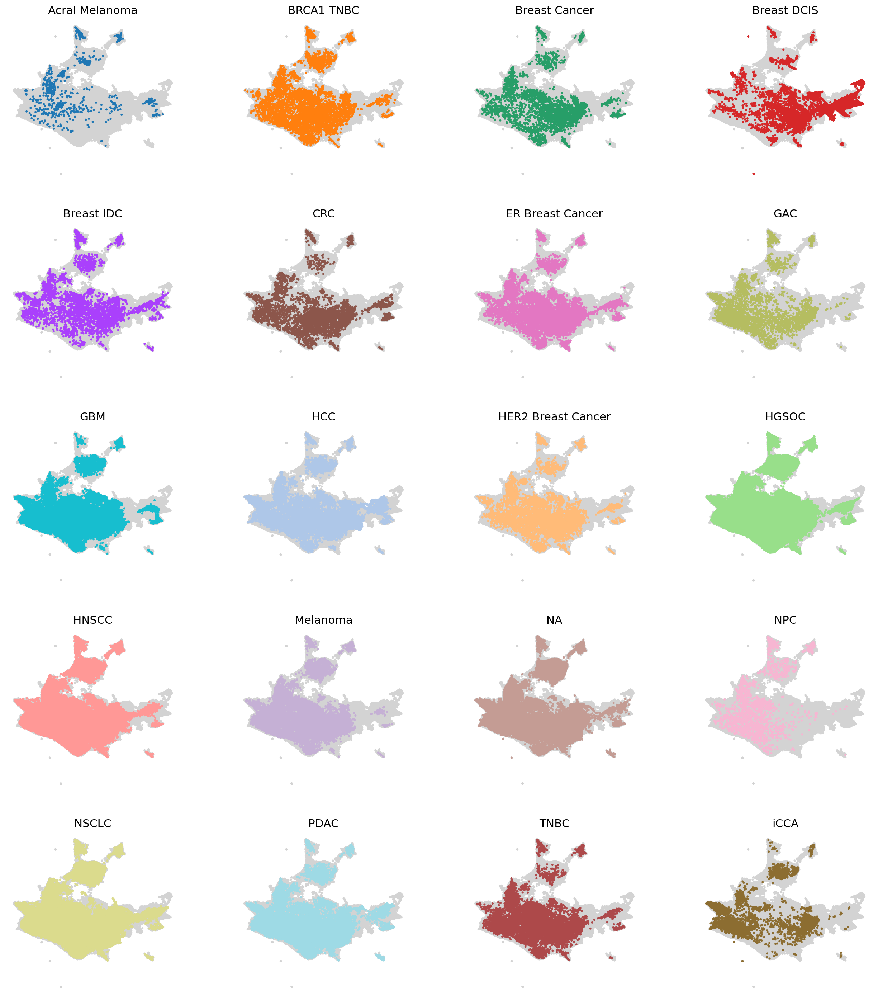

In [15]:
cluster_small_multiples(data, "cancer_subtype")

In [16]:
data

AnnData object with n_obs × n_vars = 623908 × 1634
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'sample_type_major_colors', 'cancer_subtype_colors', 'dataset_id_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

# Clustering Round 1

* cluster cells, exclude contamiating cells

### Perform clustering round 1 (~30min): 

In [17]:
sc.tl.leiden(data, resolution=0.2)

/scratch/temp/10900837/ipykernel_315545/766553368.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.


### Visualise clusters:

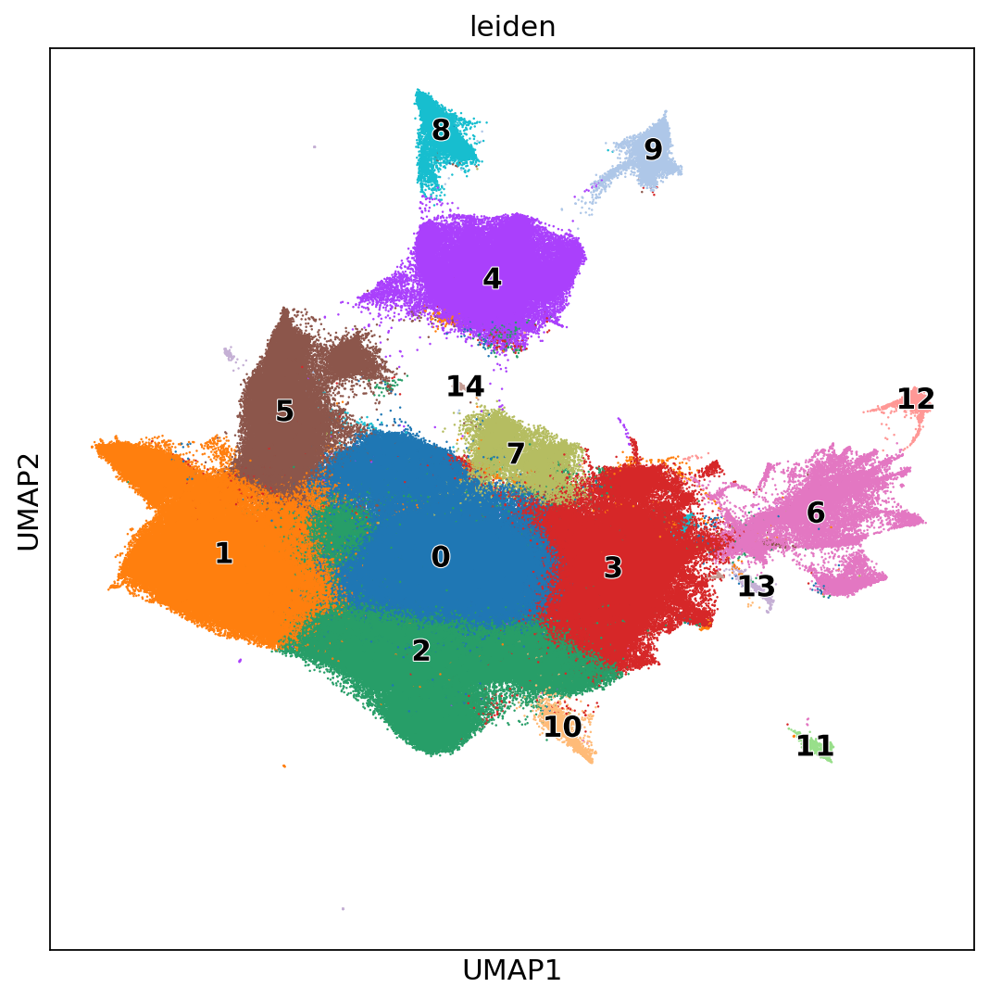

In [18]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="leiden", legend_loc="on data", legend_fontoutline=1, size=5)

### Generate dot plot with broad marker genes: 

In [19]:
broad_marker_genes = {
    "DC": ["HLA-DRA"],
    "cDC1": ["CLEC9A", "XCR1","BATF3","IRF8"],
    "cDC2": ["CD1C", "FCER1A", "CLEC10A","CD5","IRF4"],
    "DC3": ["CD1C","FCER1A","CD14","CD163"],
    "mregDC": ["LAMP3","CD274","CCR7"],
    "pDC": ["IL3RA", "CLEC4C","IRF7"],
    "Monocytes": ["CD14", "FCGR3A", "LYZ","S100A8","S100A9","CCR2"],
    "Macrophages": ["FCGR1A", "CD68","CSF1R"],
    "NK": ["NCAM1","KLRD1","NKG7","GZMB"],
    "T cells": ["CD3G", "CD8A", "CD4"],
    "B cells": ["CD19", "MS4A1"],
    "Proliferating": ["MKI67"]
}

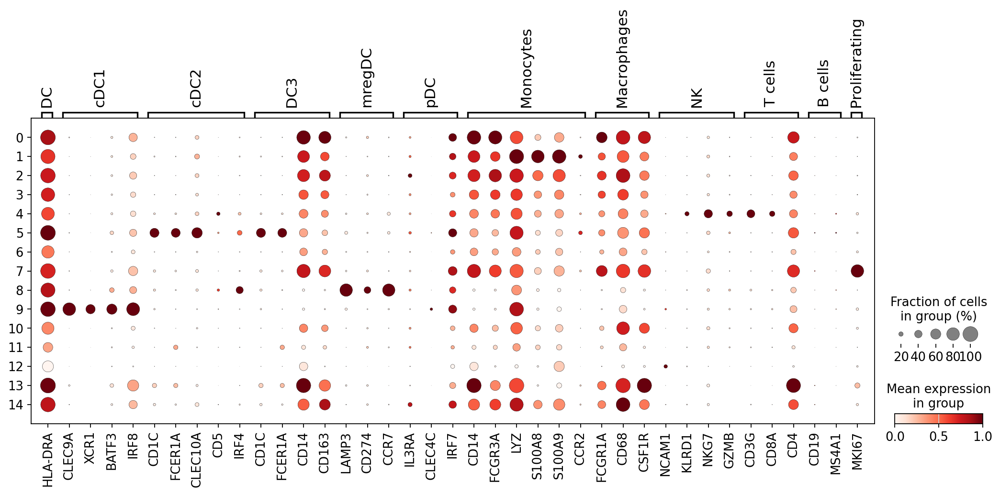

In [20]:
sc.pl.dotplot(data, broad_marker_genes, groupby="leiden", standard_scale="var")

### Generate UMAPs with broad marker genes:

In [21]:
broad_markers = ["HLA-DRA", "CLEC9A", "XCR1","BATF3","IRF8", "CD1C", "FCER1A", "CLEC10A","CD5","IRF4", "CD1C","FCER1A","CD14","CD163", "LAMP3","CD274","CCR7", "IL3RA", "CLEC4C","IRF7", "CD14", "FCGR3A", "LYZ","S100A8","S100A9","CCR2", "FCGR1A", "CD68","CSF1R", "NCAM1","KLRD1","NKG7","GZMB", "CD3G", "CD8A", "CD4", "CD19", "MS4A1","MKI67"]

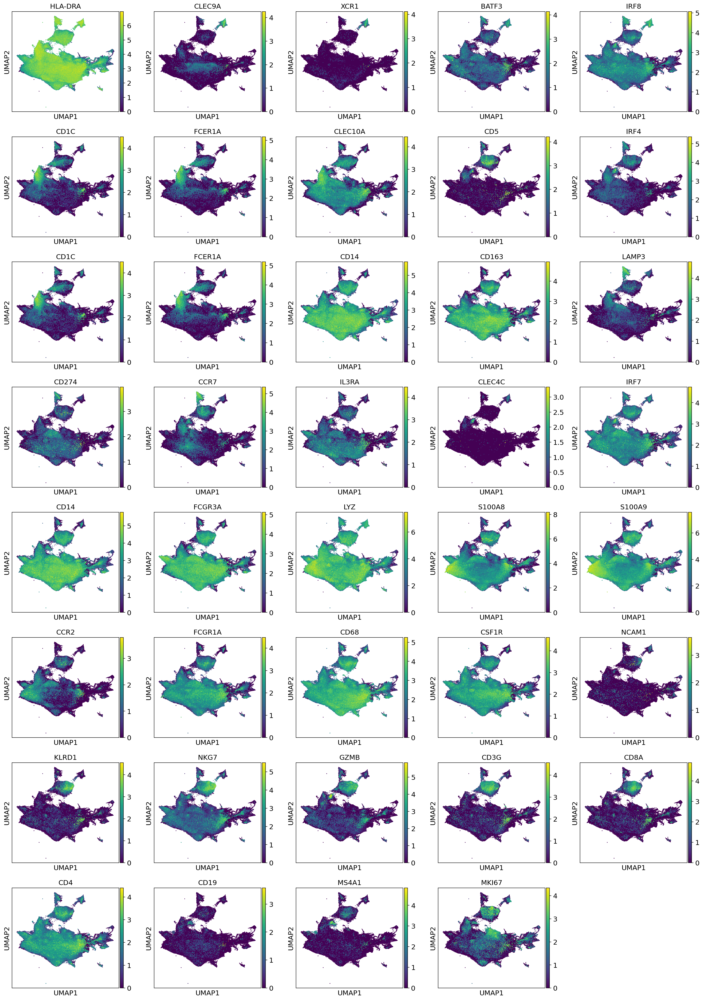

In [22]:
#plot DC/mono/mac marker genes on UMAP 
sc.pl.umap(
    data,
    color=broad_markers,
    ncols=5,
    size=5,
)


### Find DEG genes for each cluster:

In [23]:
#find DEG genes for each cluster: scanpy tute
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(data, groupby="leiden", method="wilcoxon")

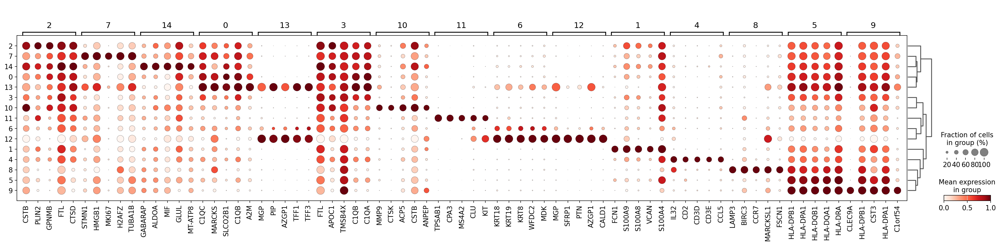

In [8]:
#visualise the top 5 DEG genes for each cluster
sc.pl.rank_genes_groups_dotplot(
    data, groupby="leiden", standard_scale="var", n_genes=5
)

## Notes from clustering round 1: 

* 0: mono
* 1: mono
* 2: myeloid
* 3: myeloid
* 4: T/NK cells - contaminants 
* 5: DC2/DC3s
* 6: keratinocytes - contaminants 
* 7: myeloid
* 8: mregDCs
* 9: DC1s
* 10: mac?
* 11: mast cells - contaminants 
* 12: epithelial/cancer - contaminants 
* 13: macs
* 14: macs

Therefore, start by excluding clusters 4, 6, 11, and 12 from further analysis


to update --> NRdata_pre-hvg based on findings here

In [6]:
#temporary export data so I can continue from here later (haven't excluded anything yet)
#data.write_h5ad("Tue_progress.h5ad", compression="gzip")
#data = sc.read_h5ad("Tue_progress.h5ad") 

In [9]:
#read in data
pre_hvg_data = sc.read_h5ad("NRdata_pre-hvg.h5ad") # this should already be normalised and log transformed

In [10]:
#make a column to store keep vs remove
pre_hvg_data.obs["keep_or_remove"] = "remove"

In [14]:
#transfer leiden clusters to pre_hvg_data
pre_hvg_data.obs["leiden"] = data.obs["leiden"]

In [15]:
pre_hvg_data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [16]:
#make a copy of the data containing just the cells I want to keep (not the contaminating ones)
clean_data1 = pre_hvg_data[~pre_hvg_data.obs["leiden"].isin(["4", "6", "11", "12"])]
#set all those in clean_data1 to keep
clean_data1.obs["keep_or_remove"] = "keep"

/scratch/temp/10904499/ipykernel_2159703/1930028017.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


In [17]:
clean_data1

AnnData object with n_obs × n_vars = 543384 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

#### update the pre_hvg object to have correct keep vs remove labels:
* I don't actually remove the remove ones from pre_hvg_data, instead they will just have a remove tag as easier to remove at the end then trying to get them back


In [19]:
#update the pre_hvg object to have correct keep vs remove labels 
pre_hvg_data.obs["keep_or_remove"].update(clean_data1.obs["keep_or_remove"]) 

/scratch/temp/10904499/ipykernel_2159703/3498810424.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




In [20]:
pre_hvg_data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [23]:
pre_hvg_data.obs

,nCount_RNA,nFeature_RNA,sample_type,cancer_type,patient_id,sample_id,percent.mt,site,sample_type_major,cancer_subtype,...,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,S_score,G2M_score,keep_or_remove,leiden
GSE215120_AM1_AAACCTGGTTGCTCCT-1,20298.000000,3789.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,0.975466,skin,primary tumour,Acral Melanoma,...,47.796802,58.758805,72.646409,198.0,5.293305,1.018047,-0.009266,-0.066821,keep,0
GSE215120_AM1_AAAGATGTCCAAATGC-1,5574.000000,1721.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,6.045928,skin,primary tumour,Acral Melanoma,...,52.529622,63.607297,78.145571,337.0,5.823046,6.338161,0.024187,0.022808,keep,0
GSE215120_AM1_AAAGTAGTCGGTGTTA-1,13432.000000,2759.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,2.151578,skin,primary tumour,Acral Melanoma,...,45.239030,58.913572,75.060837,289.0,5.669881,2.268624,-0.097721,0.017353,keep,5
GSE215120_AM1_AAATGCCCAGAGCCAA-1,17143.000000,2659.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,1.224990,skin,primary tumour,Acral Melanoma,...,58.304361,71.838975,83.281488,210.0,5.351858,1.280878,-0.044188,-0.026318,keep,5
GSE215120_AM1_AAATGCCGTTTGGCGC-1,3603.000000,1012.000000,tumour,Acral Melanoma,AM1,GSE215120_Acral_MEL_AM1,3.608104,skin,primary tumour,Acral Melanoma,...,61.722761,75.213919,87.107815,130.0,4.875197,3.707929,0.038662,0.028240,remove,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSE180661_HGSOC_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY_TTTCGATGTGACGTCC,-4.871771,-10.337130,Adnexa,HGSOC,Left Adnexa,SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,1541.000000,ovary,primary tumour,HGSOC,...,38.302073,49.489964,69.134584,196.0,5.283204,6.449490,-0.057796,-0.027219,keep,1
GSE180661_HGSOC_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY_TTTCGATTCTGCGAGC,-4.766977,-8.292435,Adnexa,HGSOC,Left Adnexa,SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,2596.000000,ovary,primary tumour,HGSOC,...,38.349007,48.544559,64.412599,343.0,5.840642,5.120167,-0.044773,-0.064710,keep,0
GSE180661_HGSOC_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY_TTTGATCGTTGCTCCT,-4.133310,-8.758132,Adnexa,HGSOC,Left Adnexa,SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,1200.000000,ovary,primary tumour,HGSOC,...,36.664967,47.832738,67.465579,136.0,4.919981,6.935237,-0.003627,-0.098217,keep,0
GSE180661_HGSOC_SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY_TTTGGAGGTACGACAG,-9.313746,-7.889039,Adnexa,HGSOC,Left Adnexa,SPECTRUM-OV-045_S1_CD45P_LEFT_OVARY,3165.000000,ovary,primary tumour,HGSOC,...,38.499131,48.664205,63.238488,778.0,6.658011,8.449175,0.032875,-0.030624,keep,5


In [24]:
# re-export pre-hvg object ready for use after next clustering
pre_hvg_data.write_h5ad("NRdata_pre-hvg.h5ad", compression="gzip")

# Integration Round 2

## now using clean_data1 repeat from hvg --> integration
* repeat from `sc.pp.highly_variable(clean_data1)` 
* repeat everything except tl.score_cell_cycle

In [25]:
clean_data1

AnnData object with n_obs × n_vars = 543384 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [28]:
#remove data and pre_hvg variables so I don't accidentally use it
del pre_hvg_data


### Identify highly variable genes:

In [29]:
# (Expects logarithimised data)
sc.pp.highly_variable_genes(clean_data1, min_mean=0.0125, max_mean=3, min_disp=0.5)
clean_data1

AnnData object with n_obs × n_vars = 543384 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [30]:
#set hidden slot
clean_data1.raw = clean_data1

In [31]:
#to get number of HV genes
print(clean_data1.var.highly_variable.sum())

1350


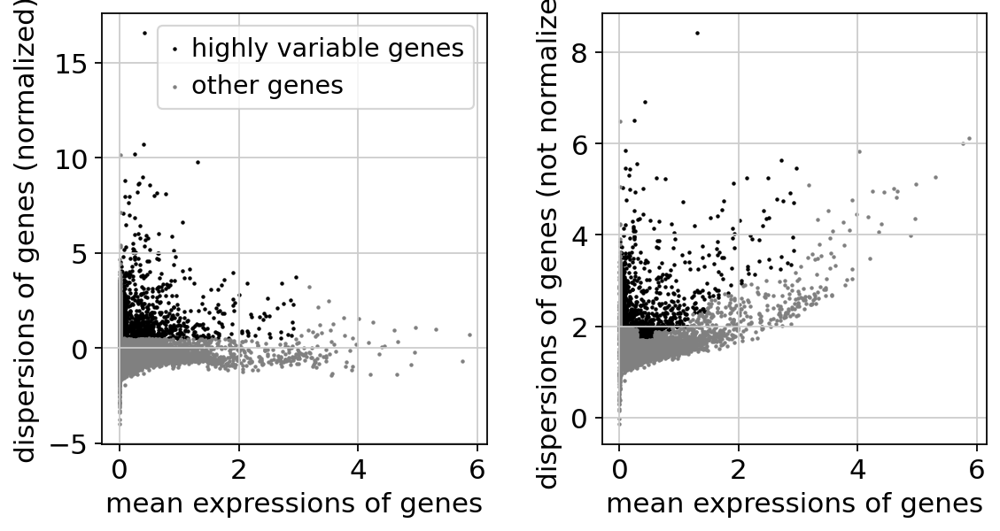

In [32]:
#plot out the number of highly variable genes
sc.pl.highly_variable_genes(clean_data1)

### Regress out necessary factors and perform scaling:

In [33]:
# Actually do the filtering for PCA
clean_data1 = clean_data1[
    :, clean_data1.var.highly_variable
].copy()  # all rows/indexes : columns only selecting for those within high_variable, and then making a copy of itself
clean_data1

AnnData object with n_obs × n_vars = 543384 × 1350
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

#### Do regression: 

In [34]:
#Regress out total counts, %mt, cycling genes (10min)
sc.pp.regress_out(clean_data1, ["total_counts", "pct_counts_mt", 'S_score', 'G2M_score'])
sc.pp.scale(clean_data1, max_value=10)

In [35]:
clean_data1

AnnData object with n_obs × n_vars = 543384 × 1350
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

### Perform PCA: 

In [36]:
## perform PCA, adjust number of PCs to calculate from default (50) to 60. (3mins)
sc.tl.pca(clean_data1, n_comps=60)

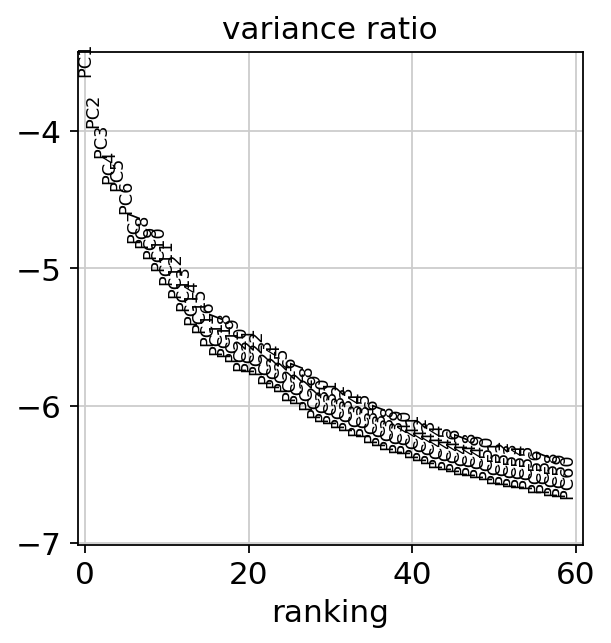

In [37]:
# make elbow plot to see variance contribution by each pc, choose inflection point
sc.pl.pca_variance_ratio(clean_data1, log=True, n_pcs=60)

### Export out the object that will be used for integration:

In [39]:
#at this point export out the object as the one we will use for integration (11min)
clean_data1.write_h5ad("NRdata_pre-int.h5ad", compression="gzip")

## Integration round 2: 
#### want to perform integration after running PCA but before computing neighbor graph (perform on NRdata_pre-int.h5ad)

### Integration step was done by submitting a job. 

* Bashscript is named: _NR_bashscript-harmony-int.sh
* python script named: _NR-script-harmony-int.py

Ran with `sbatch _NR_bashscript-harmony-int.sh`

Bashscript: 
``` bash
#!/bin/bash
#SBATCH --nodes=1
#SBATCH --ntasks-per-node=1
#SBATCH --cpus-per-task=64
#SBATCH --mem=400G
#SBATCH --job-name=NR-Integration2
#SBATCH --time=18:00:00
#SBATCH --partition=general
#SBATCH --account=a_kelvin_tuong
#SBATCH -o NR-Integration2.output
#SBATCH -e NR-Integration2.error

# export JAVA_CMD=/home/uqztuong/miniforge3/bin/java
source ~/.bashrc
mamba activate env
python3 _NR-script-harmony-int.py
```

Python script: 
``` python
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce

os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')

data_pre = sc.read_h5ad('/scratch/user/s4436039/scdata/Python_Integration_Sep/NRdata_pre-int.h5ad')

sce.pp.harmony_integrate(data_pre, 'integration_id', max_iter_harmony=200, verbose=True)

data_pre.write_h5ad("/scratch/user/s4436039/scdata/Python_Integration_Sep/NRdata_post-int.h5ad", compression="gzip")
```

### Converged after 7 iterations, took 1.5hrs

## Read in data after integration round 2:

In [6]:
#read in after integration
data = sc.read_h5ad('NRdata_post-int.h5ad')

In [7]:
data.obsm

AxisArrays with keys: X_pca, X_pca_harmony

In [8]:
#check it made new column with adjusted harmony PCs
'X_pca_harmony' in data.obsm

True

In [9]:
#assign the new PCs to the standard PCA slot
data.obsm['X_pca'] = data.obsm['X_pca_harmony']

### Neighborhood graph:

In [10]:
## Computing neighbourhood graph - here UMAP
sc.pp.neighbors(data, n_neighbors=10, n_pcs=60)

### UMAP (~6min):

In [11]:
sc.tl.umap(data, min_dist=0.3)  # 0.3 is personal preference

### UMAP Visualisation:

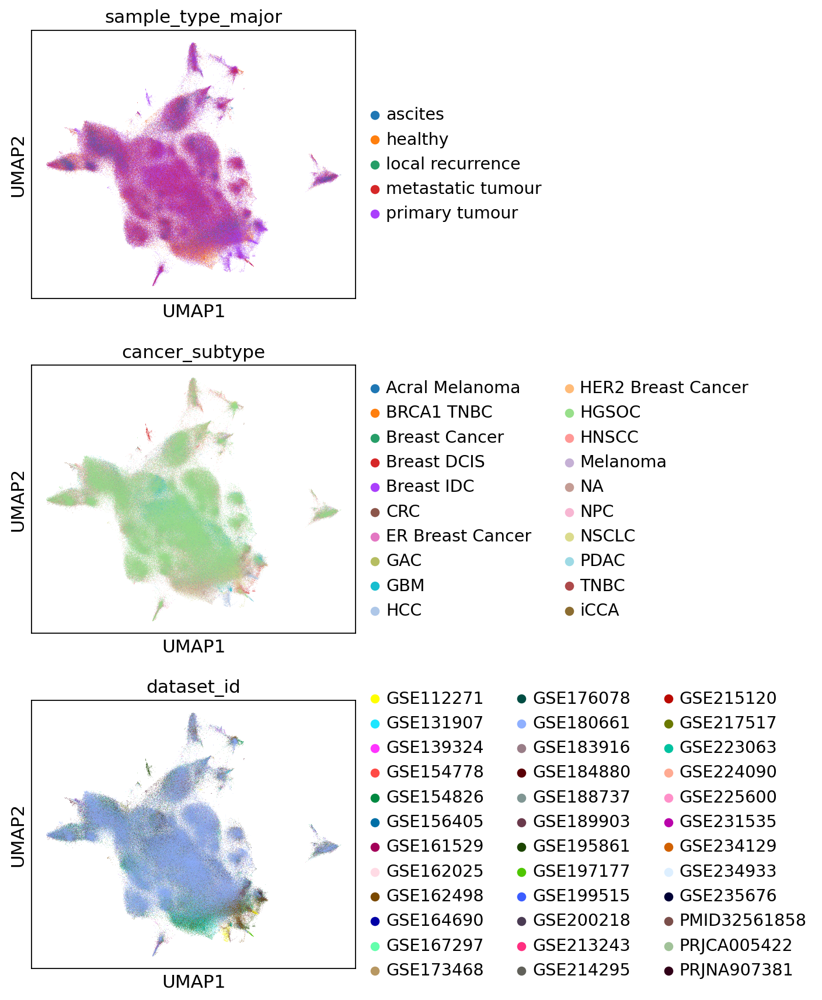

In [12]:
#same as above 
#visualise UMAP --> can see now integrated
sc.pl.umap(
    data,
    color=[
        "sample_type_major",
        "cancer_subtype",
        "dataset_id",
    ],
    ncols=1,
)

In [13]:
data

AnnData object with n_obs × n_vars = 543384 × 1350
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'sample_type_major_colors', 'cancer_subtype_colors', 'dataset_id_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 

# Clustering Round 2

* cluster cells, looking for contaminating cells

### Perform clustering round 2 (~20min): 

In [14]:
sc.tl.leiden(data, resolution=0.2)

/scratch/temp/10909585/ipykernel_2249522/766553368.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.


### Visualise clusters:

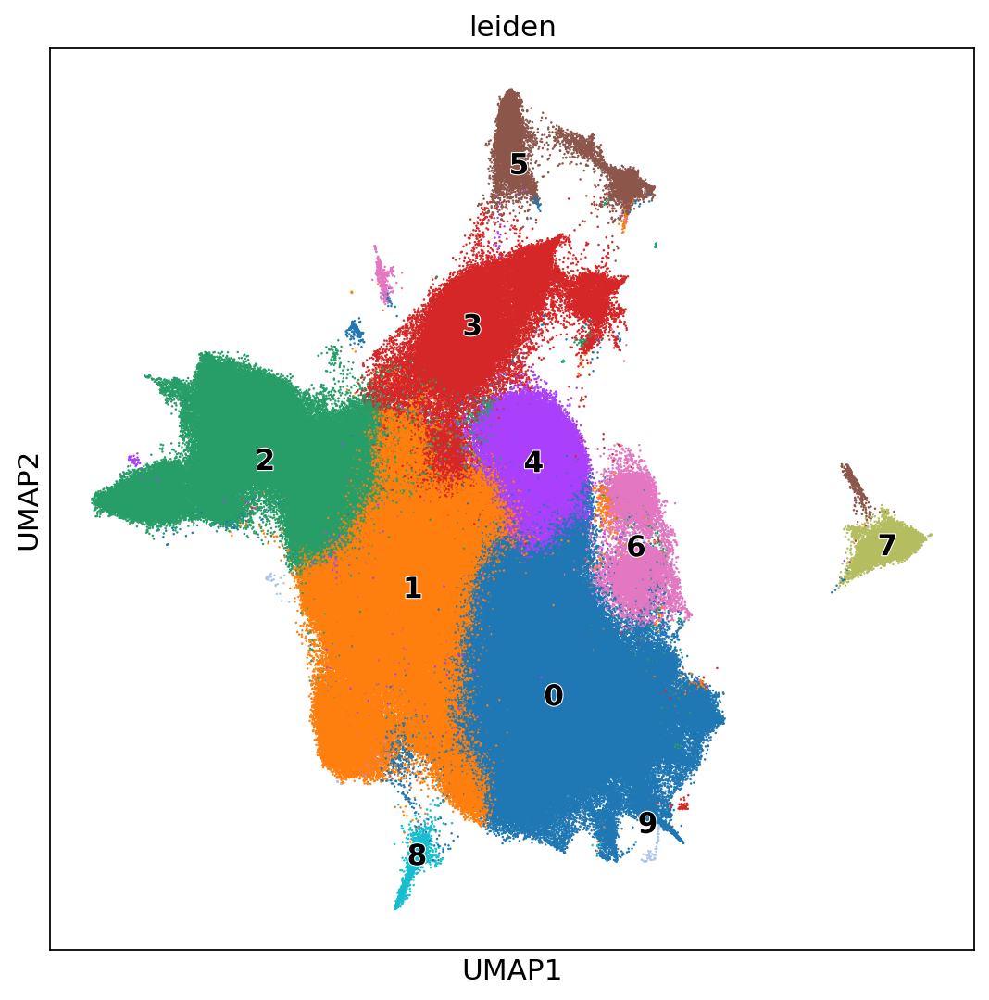

In [15]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="leiden", legend_loc="on data", legend_fontoutline=1, size=5)

#### a few of the clusters look like they are actually 2 clusters, so going to repeat clustering with higher resolution (25min):

In [14]:
sc.tl.leiden(data, resolution=0.4)

/scratch/temp/10911625/ipykernel_2216849/249652329.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.


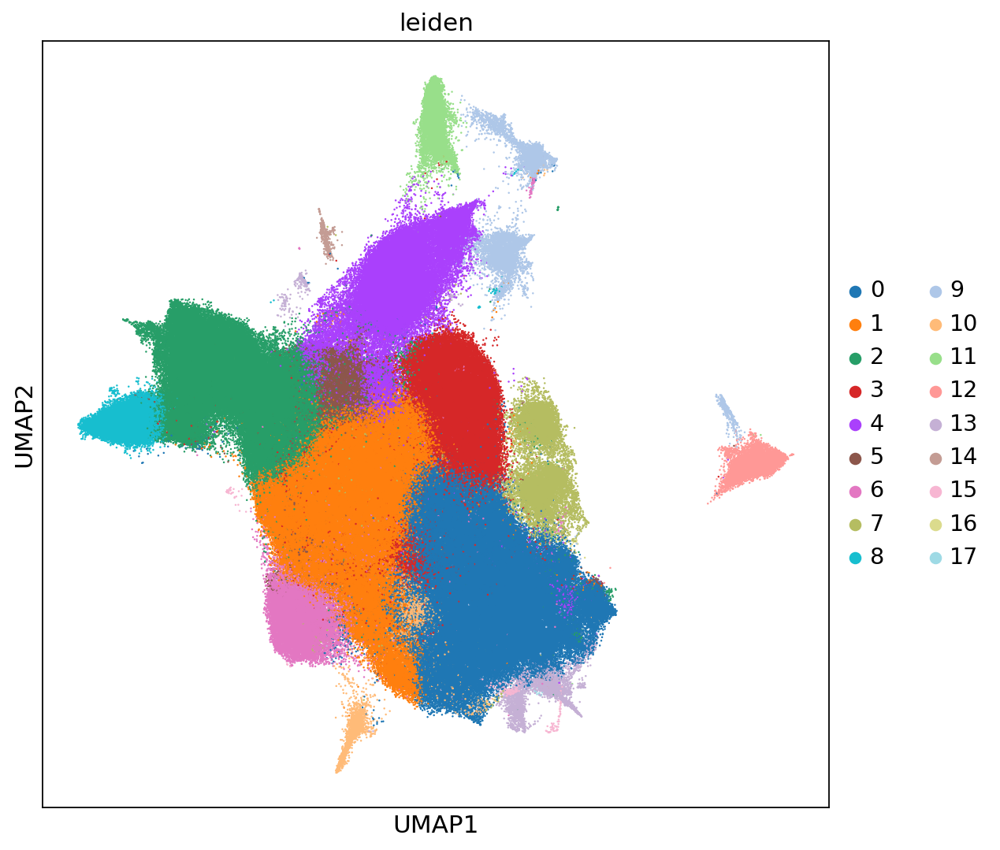

In [16]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="leiden", size=5)

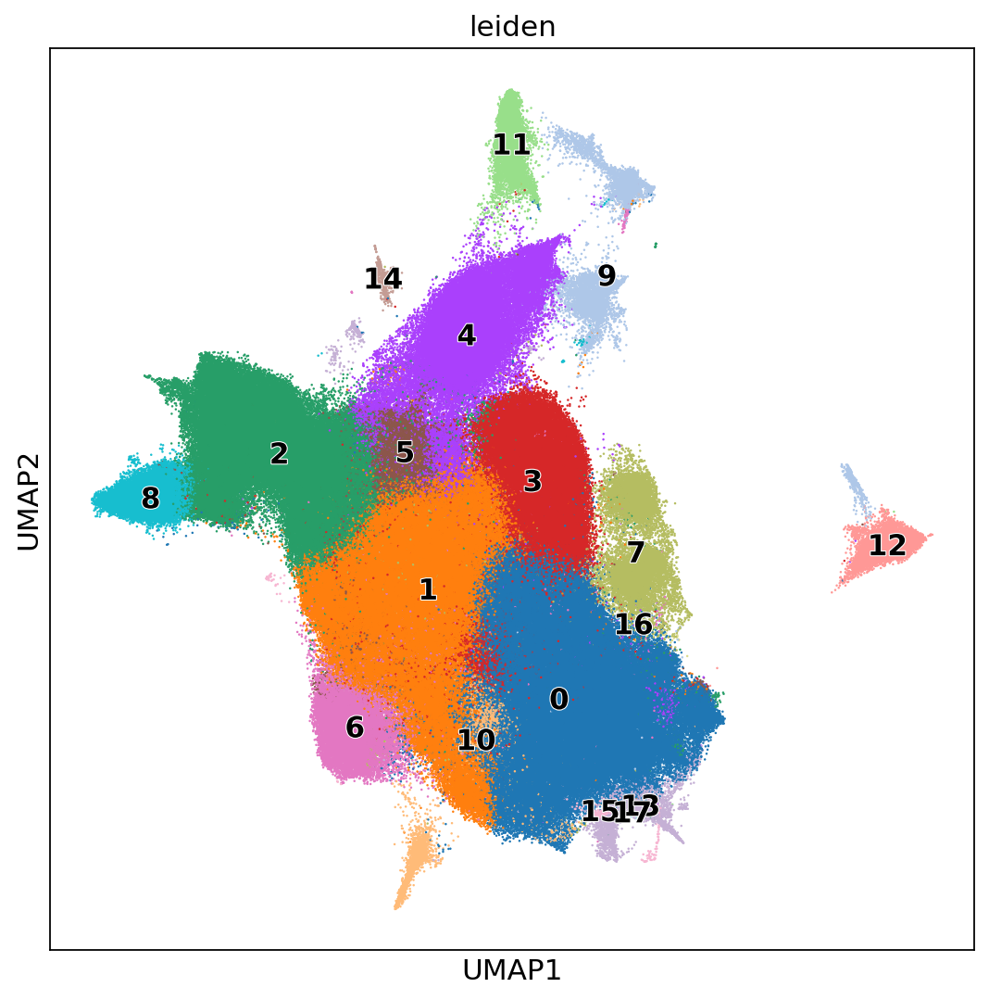

In [23]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="leiden", legend_loc="on data", legend_fontoutline=1, size=5)

### Generate dot plot with broad marker genes: 

In [17]:
broad_marker_genes = {
    "DC": ["HLA-DRA"],
    "cDC1": ["CLEC9A", "XCR1","BATF3","IRF8"],
    "cDC2": ["CD1C", "FCER1A", "CLEC10A","CD5","IRF4"],
    "DC3": ["CD1C","FCER1A","CD14","CD163"],
    "mregDC": ["LAMP3","CD274","CCR7"],
    "pDC": ["IL3RA", "CLEC4C","IRF7"],
    "Monocytes": ["CD14", "FCGR3A", "LYZ","S100A8","S100A9","CCR2"],
    "Macrophages": ["FCGR1A", "CD68","CSF1R"],
    "NK": ["NCAM1","KLRD1","NKG7","GZMB"],
    "T cells": ["CD3G", "CD8A", "CD4"],
    "B cells": ["CD19", "MS4A1"],
    "Proliferating": ["MKI67"]
}

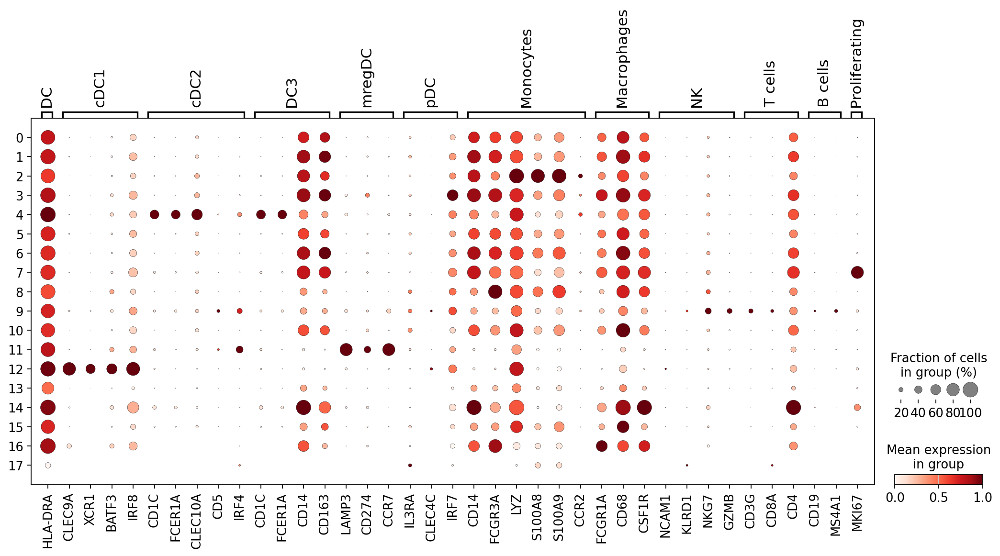

In [18]:
sc.pl.dotplot(data, broad_marker_genes, groupby="leiden", standard_scale="var")

### Generate UMAPs with broad marker genes:

In [19]:
broad_markers = ["HLA-DRA", "CLEC9A", "XCR1","BATF3","IRF8", "CD1C", "FCER1A", "CLEC10A","CD5","IRF4", "CD1C","FCER1A","CD14","CD163", "LAMP3","CD274","CCR7", "IL3RA", "CLEC4C","IRF7", "CD14", "FCGR3A", "LYZ","S100A8","S100A9","CCR2", "FCGR1A", "CD68","CSF1R", "NCAM1","KLRD1","NKG7","GZMB", "CD3G", "CD8A", "CD4", "CD19", "MS4A1","MKI67"]

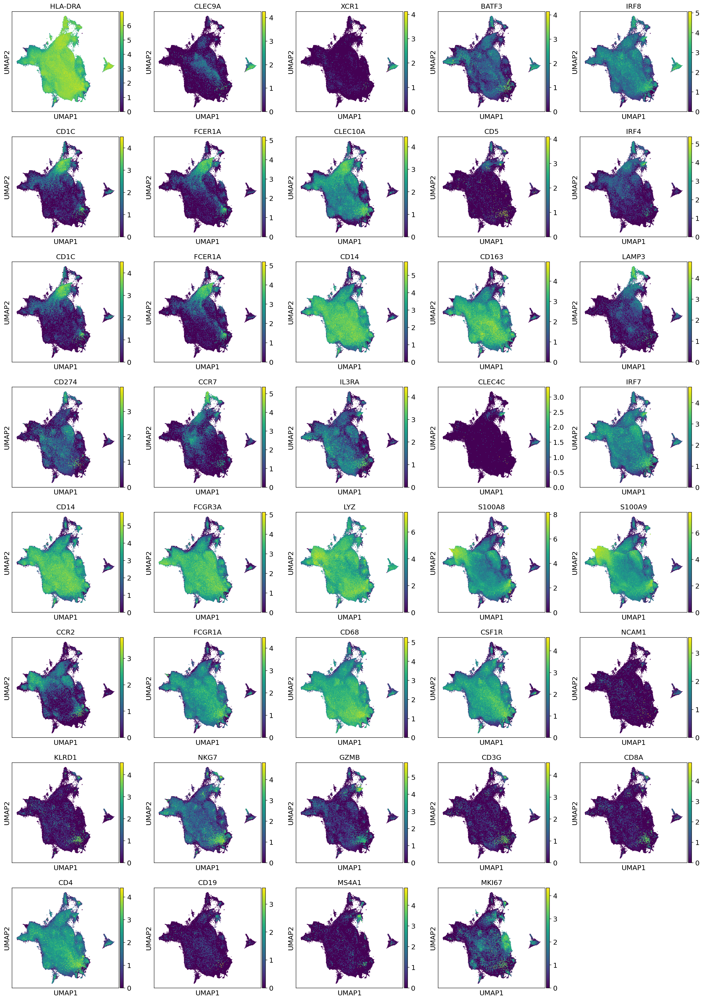

In [20]:
#plot DC/mono/mac marker genes on UMAP 
sc.pl.umap(
    data,
    color=broad_markers,
    ncols=5,
    size=5,
)


### Find DEG genes for each cluster:

In [21]:
#find DEG genes for each cluster: scanpy tute
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(data, groupby="leiden", method="wilcoxon")

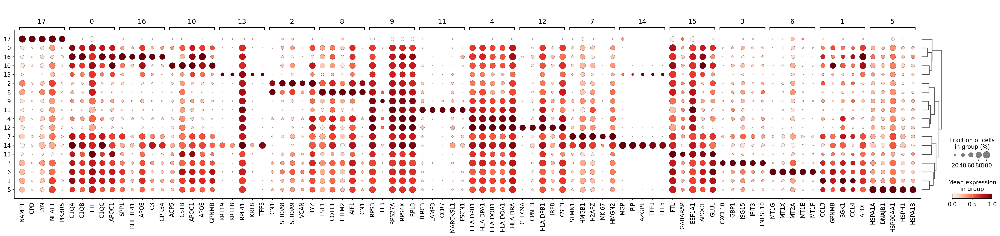

In [22]:
#visualise the top 5 DEG genes for each cluster
sc.pl.rank_genes_groups_dotplot(
    data, groupby="leiden", standard_scale="var", n_genes=5
)

## Notes from clustering round 2: 

* 0: myeloid
* 1: myeloid
* 2: monocytes
* 3: myeloid
* 4: DC2/DC3
* 5: myeloid
* 6: myeloid
* 7: myeloid
* 8: myeloid
* 9: contaminants - T/NK/B cells (small fraction expressing NK/T cells markers, lack other myeloid markers) and their DEG genes are: RPS3, LTB, RPS27A, RPS4X, RPL3 - ribosomal proteins?
* 10: myeloid
* 11: mregDC
* 12: cDC1
* 13: contaminants - epithelial cells (KRT19, KRT18, RPL41, KRT8, TFF3) and lack myeloid markers
* 14: macs
* 15: macs
* 16: macs
* 17: contaminants - ??? (NAMPT, CPD, LYN, NEAT1, PIK3R5) and lack myeloid markers, maybe cancer cells?


Therefore, exclude clusters 9, 13, 17


to update --> NRdata_pre-hvg based on findings here

In [10]:
#read in data
pre_hvg_data = sc.read_h5ad("NRdata_pre-hvg.h5ad") # this should already be normalised and log transformed

In [11]:
pre_hvg_data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [12]:
# check how many keep vs remove
keep_counts = pre_hvg_data.obs['keep_or_remove'].value_counts()
print(keep_counts)

keep_or_remove
keep      543384
remove     80524
Name: count, dtype: int64


In [13]:
#transfer new leiden clusters to pre_hvg_data
pre_hvg_data.obs["leiden"] = data.obs["leiden"]

In [16]:
#make a copy of the data containing just the cells I want to remove (ontaminating ones)
remove_data = pre_hvg_data[pre_hvg_data.obs["leiden"].isin(["9", "13", "17"])]

In [17]:
remove_data

View of AnnData object with n_obs × n_vars = 14143 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [19]:
#set all those in remove_data to remove
remove_data.obs["keep_or_remove"] = "remove"

/scratch/temp/10912648/ipykernel_3980393/2611375217.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


#### update the pre_hvg object to have correct keep vs remove labels:
* I don't actually remove the remove ones from pre_hvg_data, instead they will just have a remove tag as easier to remove at the end then trying to get them back


In [21]:
#update the pre_hvg object to have correct keep vs remove labels 
pre_hvg_data.obs["keep_or_remove"].update(remove_data.obs["keep_or_remove"]) 

/scratch/temp/10912648/ipykernel_3980393/900079214.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




In [22]:
pre_hvg_data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [23]:
# check how many keep vs remove
keep_counts = pre_hvg_data.obs['keep_or_remove'].value_counts()
print(keep_counts)

keep_or_remove
keep      529241
remove     94667
Name: count, dtype: int64


In [24]:
# re-export pre-hvg object ready for use after next clustering
pre_hvg_data.write_h5ad("NRdata_pre-hvg.h5ad", compression="gzip")

In [29]:
#now make a copy of the data containing just the cells I want to keep for the next round 
clean_data2 = pre_hvg_data[pre_hvg_data.obs["keep_or_remove"].isin(["keep"])]

In [30]:
clean_data2

View of AnnData object with n_obs × n_vars = 529241 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [31]:
# check how many keep vs remove
keep_counts = clean_data2.obs['keep_or_remove'].value_counts()
print(keep_counts)

keep_or_remove
keep    529241
Name: count, dtype: int64


In [32]:
#export clean_data2 to continue from here tomorrow
#clean_data2.write_h5ad("Wed_ready.h5ad", compression="gzip")

In [7]:
#read in data
#clean_data2 = sc.read_h5ad("Wed_ready.h5ad") 

# Integration Round 3

## now using clean_data2 repeat from hvg --> integration round 3
* repeat from `sc.pp.highly_variable(clean_data2)` 
* repeat everything except tl.score_cell_cycle

In [8]:
clean_data2

AnnData object with n_obs × n_vars = 529241 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [ ]:
#remove data and pre_hvg variables so I don't accidentally use it
#del pre_hvg_data
#del data

### Identify highly variable genes:

In [9]:
# (Expects logarithimised data)
sc.pp.highly_variable_genes(clean_data2, min_mean=0.0125, max_mean=3, min_disp=0.5)
clean_data2

AnnData object with n_obs × n_vars = 529241 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [10]:
#set hidden slot
clean_data2.raw = clean_data2

In [11]:
#to get number of HV genes
print(clean_data2.var.highly_variable.sum())

1295


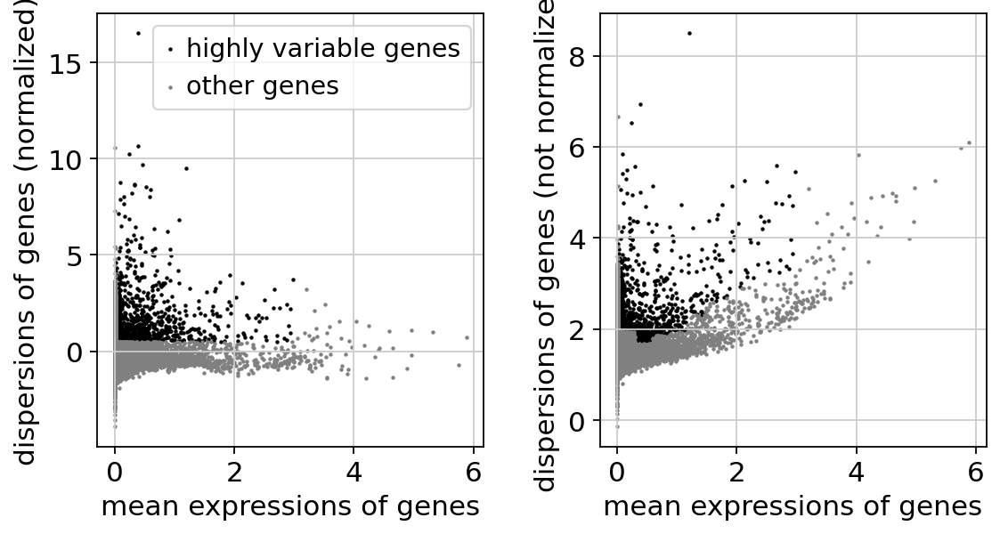

In [12]:
#plot out the number of highly variable genes
sc.pl.highly_variable_genes(clean_data2)

### Regress out necessary factors and perform scaling:

In [13]:
# Actually do the filtering for PCA
clean_data2 = clean_data2[
    :, clean_data2.var.highly_variable
].copy()  # all rows/indexes : columns only selecting for those within high_variable, and then making a copy of itself
clean_data2

AnnData object with n_obs × n_vars = 529241 × 1295
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

#### Do regression: 

In [14]:
#Regress out total counts, %mt, cycling genes (10min)
sc.pp.regress_out(clean_data2, ["total_counts", "pct_counts_mt", 'S_score', 'G2M_score'])
sc.pp.scale(clean_data2, max_value=10)

In [15]:
clean_data2

AnnData object with n_obs × n_vars = 529241 × 1295
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

### Perform PCA: 

In [16]:
## perform PCA, adjust number of PCs to calculate from default (50) to 60. (3mins)
sc.tl.pca(clean_data2, n_comps=60)

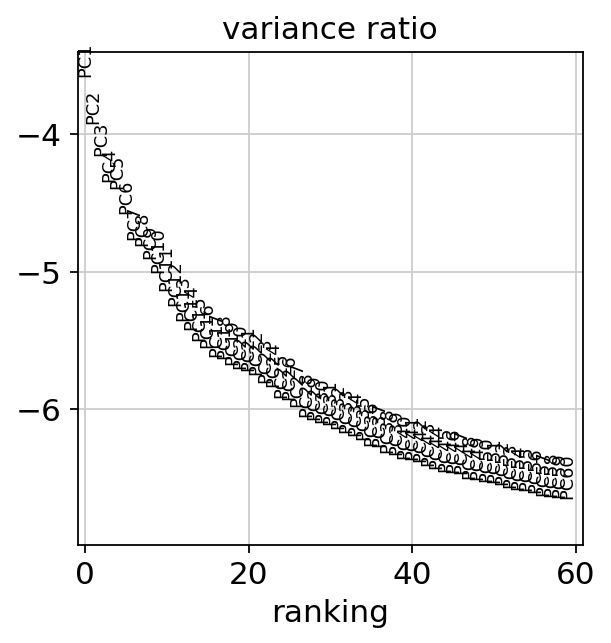

In [18]:
# make elbow plot to see variance contribution by each pc, choose inflection point
sc.pl.pca_variance_ratio(clean_data2, log=True, n_pcs=60)

### Export out the object that will be used for integration:

In [19]:
#at this point export out the object as the one we will use for integration (11min)
clean_data2.write_h5ad("NRdata_pre-int.h5ad", compression="gzip")

## Integration round 3: 
#### want to perform integration after running PCA but before computing neighbor graph (perform on NRdata_pre-int.h5ad)

### Integration step was done by submitting a job. 

* Bashscript is named: _NR_bashscript-harmony-int.sh
* python script named: _NR-script-harmony-int.py

Ran with `sbatch _NR_bashscript-harmony-int.sh`

Bashscript: 
``` bash
#!/bin/bash
#SBATCH --nodes=1
#SBATCH --ntasks-per-node=1
#SBATCH --cpus-per-task=64
#SBATCH --mem=200G
#SBATCH --job-name=NR-Integration3
#SBATCH --time=4:00:00
#SBATCH --partition=general
#SBATCH --account=a_kelvin_tuong
#SBATCH -o NR-Integration3.output
#SBATCH -e NR-Integration3.error

# export JAVA_CMD=/home/uqztuong/miniforge3/bin/java
source ~/.bashrc
mamba activate env
python3 _NR-script-harmony-int.py
```

Python script: 
``` python
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce

os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')

data_pre = sc.read_h5ad('/scratch/user/s4436039/scdata/Python_Integration_Sep/NRdata_pre-int.h5ad')

sce.pp.harmony_integrate(data_pre, 'integration_id', max_iter_harmony=200, verbose=True)

data_pre.write_h5ad("/scratch/user/s4436039/scdata/Python_Integration_Sep/NRdata_post-int.h5ad", compression="gzip")
```

### Converged after 7 iterations, took 2hrs

## Read in data after integration round 3:

In [6]:
#read in after integration
data = sc.read_h5ad('NRdata_post-int.h5ad')

In [7]:
data.obsm

AxisArrays with keys: X_pca, X_pca_harmony

In [8]:
#check it made new column with adjusted harmony PCs
'X_pca_harmony' in data.obsm

True

In [9]:
#assign the new PCs to the standard PCA slot
data.obsm['X_pca'] = data.obsm['X_pca_harmony']

### Neighborhood graph:

In [10]:
## Computing neighbourhood graph - here UMAP
sc.pp.neighbors(data, n_neighbors=10, n_pcs=60)

### UMAP (~7min):

In [11]:
sc.tl.umap(data, min_dist=0.3)  # 0.3 is personal preference

### UMAP Visualisation:

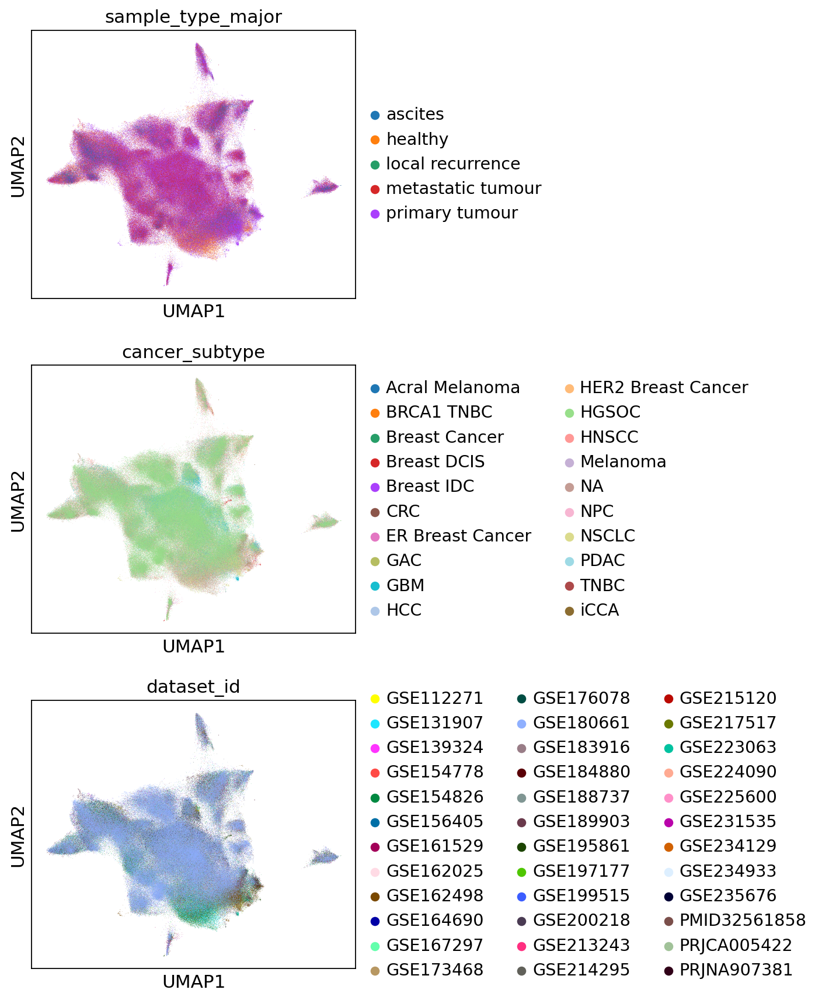

In [12]:
#visualise UMAP --> can see now integrated
sc.pl.umap(
    data,
    color=[
        "sample_type_major",
        "cancer_subtype",
        "dataset_id",
    ],
    ncols=1,
)

In [13]:
data

AnnData object with n_obs × n_vars = 529241 × 1295
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'sample_type_major_colors', 'cancer_subtype_colors', 'dataset_id_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 

# Clustering Round 3

* cluster cells, seperate out DC and macs/mono

### Perform clustering round 3 (~16min): 

In [14]:
sc.tl.leiden(data, resolution=0.3)

/scratch/temp/10917314/ipykernel_121589/1764672217.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.


### Visualise clusters:

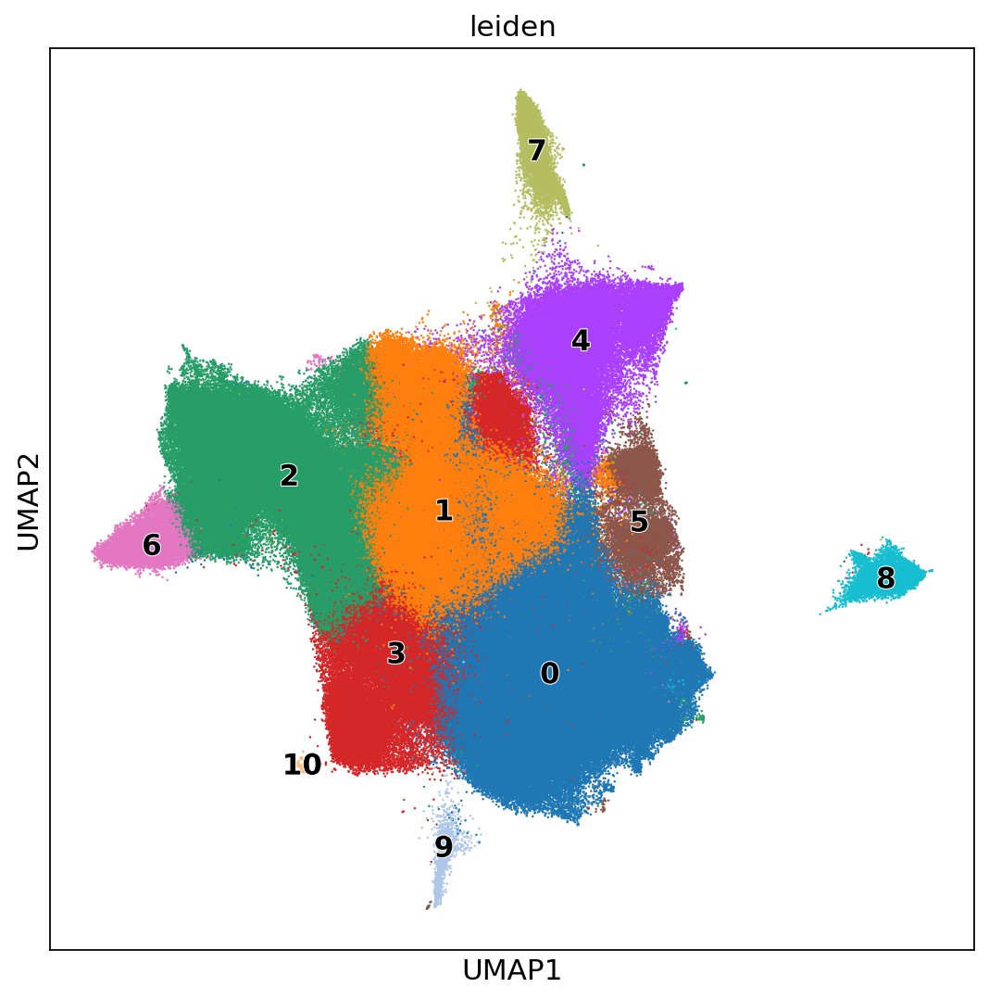

In [15]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="leiden", legend_loc="on data", legend_fontoutline=1, size=5)

### Generate dot plot with broad marker genes: 

In [16]:
broad_marker_genes = {
    "DC": ["HLA-DRA"],
    "cDC1": ["CLEC9A", "XCR1","BATF3","IRF8"],
    "cDC2": ["CD1C", "FCER1A", "CLEC10A","CD5","IRF4"],
    "DC3": ["CD1C","FCER1A","CD14","CD163"],
    "mregDC": ["LAMP3","CD274","CCR7"],
    "pDC": ["IL3RA", "CLEC4C","IRF7"],
    "Monocytes": ["CD14", "FCGR3A", "LYZ","S100A8","S100A9","CCR2"],
    "Macrophages": ["FCGR1A", "CD68","CSF1R"],
    "NK": ["NCAM1","KLRD1","NKG7","GZMB"],
    "T cells": ["CD3G", "CD8A", "CD4"],
    "B cells": ["CD19", "MS4A1"],
    "Proliferating": ["MKI67"]
}

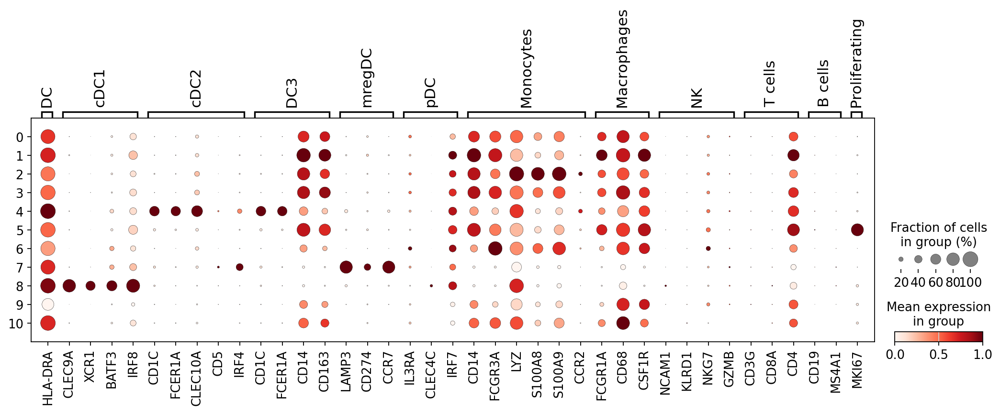

In [17]:
sc.pl.dotplot(data, broad_marker_genes, groupby="leiden", standard_scale="var")

### Generate UMAPs with broad marker genes:

In [23]:
broad_markers = ["HLA-DRA", "CLEC9A", "XCR1","BATF3","IRF8", "CD1C", "FCER1A", "CLEC10A","CD5","IRF4", "CD14","CD163", "LAMP3","CD274","CCR7", "IRF7", "CD14", "FCGR3A", "LYZ","S100A8","S100A9","CCR2", "FCGR1A", "CD68","CSF1R","MKI67"]

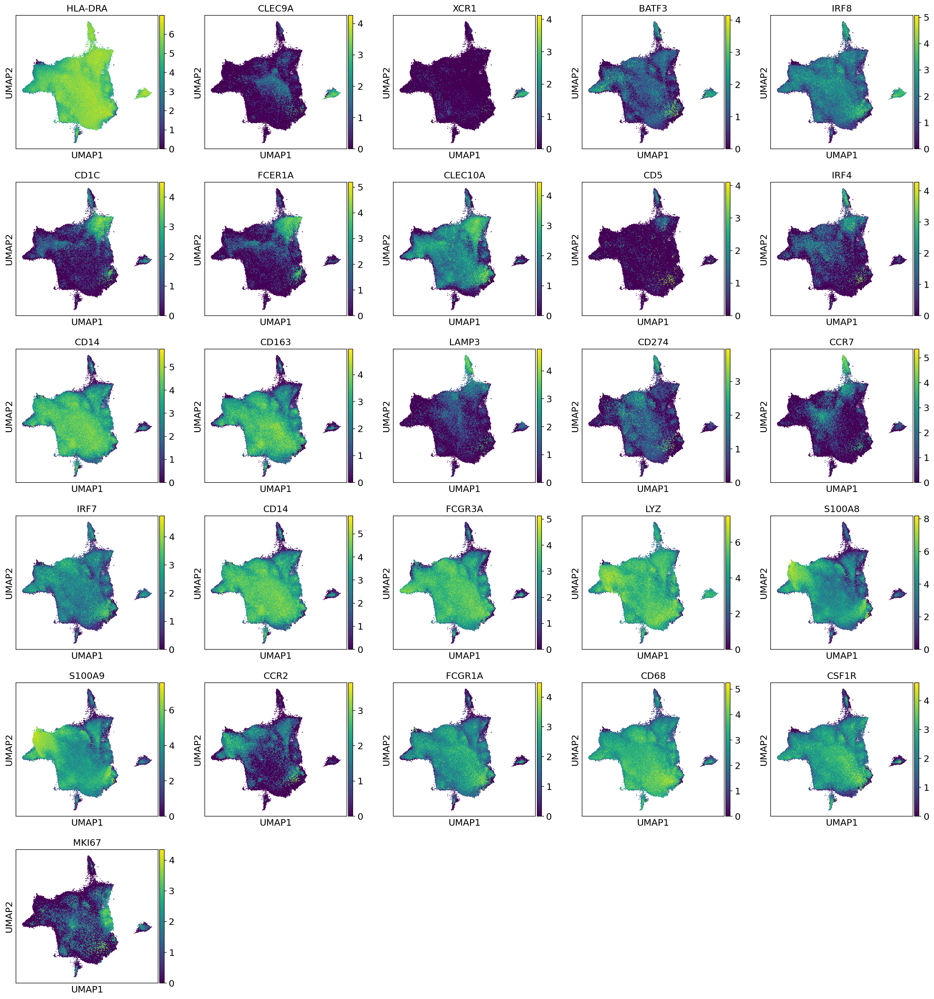

In [24]:
#plot DC/mono/mac marker genes on UMAP 
sc.pl.umap(
    data,
    color=broad_markers,
    ncols=5,
    size=5,
)


### Find DEG genes for each cluster:

In [20]:
#find DEG genes for each cluster: scanpy tute
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(data, groupby="leiden", method="wilcoxon")

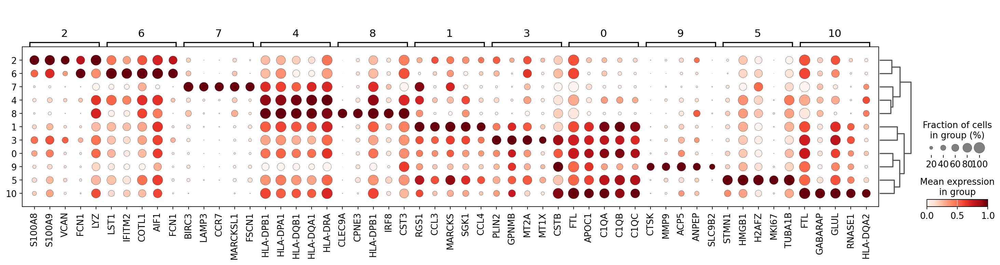

In [21]:
#visualise the top 5 DEG genes for each cluster
sc.pl.rank_genes_groups_dotplot(
    data, groupby="leiden", standard_scale="var", n_genes=5
)

In [6]:
#export to continue later
#data.write_h5ad("Thu_break.h5ad", compression="gzip")
data = sc.read_h5ad("Thu_break.h5ad") 

## Notes from clustering round 3: 

DC defined as clusters with high HLA-DR and canonical DC markers. These are clusters 4 (cDC2/DC3), 7 (mregDC), and 8 (cDC1). All other clusters taken as macrophages/monocytes. 

Therefore, I am going to divide my dataset in two (one for DC, and one for mono/mac) and then repeat integration on each seperately.

to update --> NRdata_pre-hvg based on findings here

In [7]:
#read in data
pre_hvg_data = sc.read_h5ad("NRdata_pre-hvg.h5ad") # this should already be normalised and log transformed

In [8]:
pre_hvg_data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [9]:
# check how many keep vs remove
keep_counts = pre_hvg_data.obs['keep_or_remove'].value_counts()
print(keep_counts)

keep_or_remove
keep      529241
remove     94667
Name: count, dtype: int64


In [10]:
#transfer new leiden clusters to pre_hvg_data
pre_hvg_data.obs["leiden"] = data.obs["leiden"]

In [11]:
#make a new column called celltype
pre_hvg_data.obs["celltype"] = "unknown" # only run this first time

In [12]:
#make a copy of the data containing just the cells labelled keep
keep_data = pre_hvg_data[pre_hvg_data.obs["keep_or_remove"].isin(["keep"])]

In [13]:
keep_data

View of AnnData object with n_obs × n_vars = 529241 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [14]:
#from this make a copy of the data containing just the DCs or just the macs/monos
dc_data = keep_data[keep_data.obs["leiden"].isin(["4", "7", "8"])]
M_data = keep_data[~keep_data.obs["leiden"].isin(["4", "7", "8"])]

In [15]:
dc_data

View of AnnData object with n_obs × n_vars = 53144 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [16]:
M_data

View of AnnData object with n_obs × n_vars = 476097 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [17]:
#set all those in dc_data to DC and those in M_data to mono/mac
dc_data.obs["celltype"] = "DC"
M_data.obs["celltype"] = "mono/mac"

/scratch/temp/10919688/ipykernel_3104202/2078367130.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
/scratch/temp/10919688/ipykernel_3104202/2078367130.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


#### update the pre_hvg object to have correct celltype labels:

In [18]:
#update the pre_hvg object to have correct celltype labels 
pre_hvg_data.obs["celltype"].update(dc_data.obs["celltype"]) 
pre_hvg_data.obs["celltype"].update(M_data.obs["celltype"]) 

/scratch/temp/10919688/ipykernel_3104202/1652820352.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




In [19]:
pre_hvg_data

AnnData object with n_obs × n_vars = 623908 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [20]:
# check how many keep vs remove
keep_counts = pre_hvg_data.obs['keep_or_remove'].value_counts()
print(keep_counts)

keep_or_remove
keep      529241
remove     94667
Name: count, dtype: int64


In [21]:
# check how many DC vs mono/macs
type_counts = pre_hvg_data.obs['celltype'].value_counts()
print(type_counts)

celltype
mono/mac    476097
unknown      94667
DC           53144
Name: count, dtype: int64


In [22]:
# re-export pre-hvg object ready for use after next clustering
pre_hvg_data.write_h5ad("NRdata_pre-hvg.h5ad", compression="gzip")

In [23]:
#export dc_data and M_data to save at this point
dc_data.write_h5ad("dc_data.h5ad", compression="gzip")
M_data.write_h5ad("M_data.h5ad", compression="gzip")

# Integration on DC only:

## now using dc_data repeat from hvg --> integration

In [ ]:
dc_data

AnnData object with n_obs × n_vars = 529241 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [ ]:
#remove variables I don't need 
#del pre_hvg_data
#del data

### Identify highly variable genes:

In [ ]:
# (Expects logarithimised data)
sc.pp.highly_variable_genes(clean_data2, min_mean=0.0125, max_mean=3, min_disp=0.5)
clean_data2

AnnData object with n_obs × n_vars = 529241 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [ ]:
#set hidden slot
clean_data2.raw = clean_data2

In [ ]:
#to get number of HV genes
print(clean_data2.var.highly_variable.sum())

1295


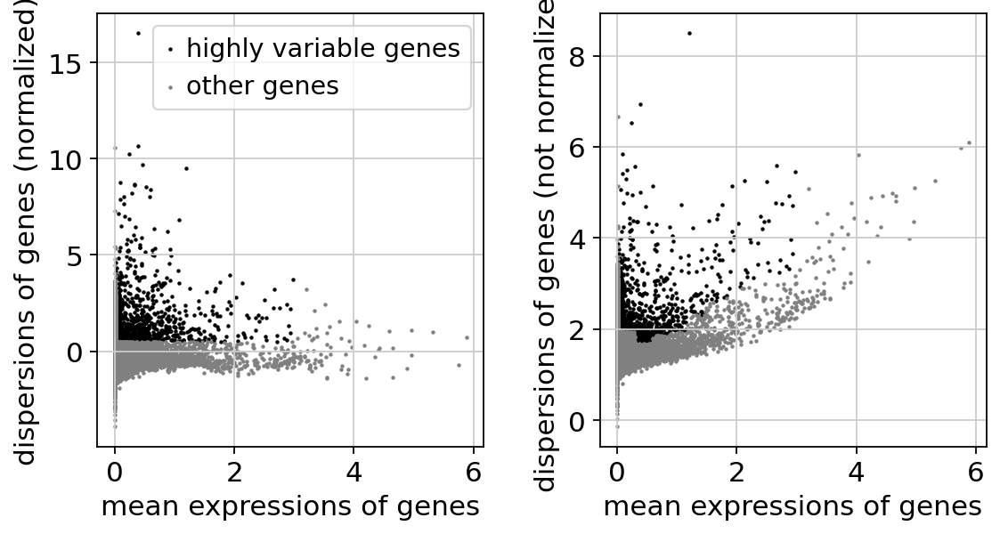

In [ ]:
#plot out the number of highly variable genes
sc.pl.highly_variable_genes(clean_data2)

### Regress out necessary factors and perform scaling:

In [ ]:
# Actually do the filtering for PCA
clean_data2 = clean_data2[
    :, clean_data2.var.highly_variable
].copy()  # all rows/indexes : columns only selecting for those within high_variable, and then making a copy of itself
clean_data2

AnnData object with n_obs × n_vars = 529241 × 1295
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

#### Do regression: 

In [ ]:
#Regress out total counts, %mt, cycling genes (10min)
sc.pp.regress_out(clean_data2, ["total_counts", "pct_counts_mt", 'S_score', 'G2M_score'])
sc.pp.scale(clean_data2, max_value=10)

In [ ]:
clean_data2

AnnData object with n_obs × n_vars = 529241 × 1295
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

### Perform PCA: 

In [ ]:
## perform PCA, adjust number of PCs to calculate from default (50) to 60. (3mins)
sc.tl.pca(clean_data2, n_comps=60)

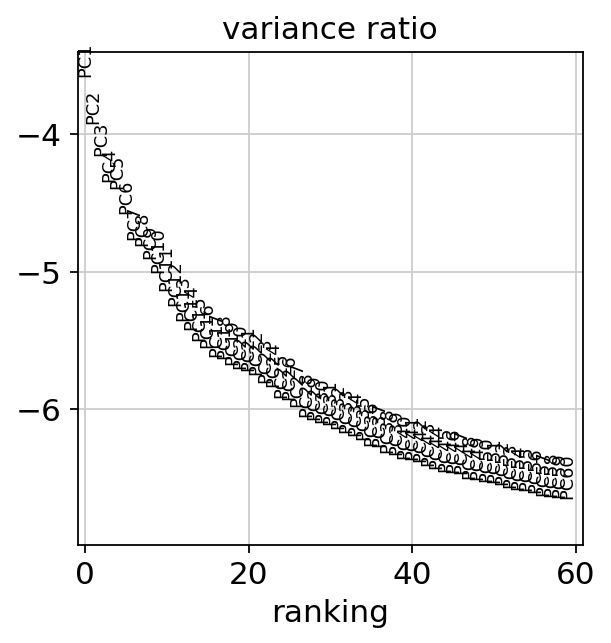

In [ ]:
# make elbow plot to see variance contribution by each pc, choose inflection point
sc.pl.pca_variance_ratio(clean_data2, log=True, n_pcs=60)

### Export out the object that will be used for integration:

In [ ]:
#at this point export out the object as the one we will use for integration (11min)
clean_data2.write_h5ad("NRdata_pre-int.h5ad", compression="gzip")

## Integration round 3: 
#### want to perform integration after running PCA but before computing neighbor graph (perform on NRdata_pre-int.h5ad)

### Integration step was done by submitting a job. 

* Bashscript is named: _NR_bashscript-harmony-int.sh
* python script named: _NR-script-harmony-int.py

Ran with `sbatch _NR_bashscript-harmony-int.sh`

Bashscript: 
``` bash
#!/bin/bash
#SBATCH --nodes=1
#SBATCH --ntasks-per-node=1
#SBATCH --cpus-per-task=64
#SBATCH --mem=200G
#SBATCH --job-name=NR-Integration3
#SBATCH --time=4:00:00
#SBATCH --partition=general
#SBATCH --account=a_kelvin_tuong
#SBATCH -o NR-Integration3.output
#SBATCH -e NR-Integration3.error

# export JAVA_CMD=/home/uqztuong/miniforge3/bin/java
source ~/.bashrc
mamba activate env
python3 _NR-script-harmony-int.py
```

Python script: 
``` python
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce

os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')

data_pre = sc.read_h5ad('/scratch/user/s4436039/scdata/Python_Integration_Sep/NRdata_pre-int.h5ad')

sce.pp.harmony_integrate(data_pre, 'integration_id', max_iter_harmony=200, verbose=True)

data_pre.write_h5ad("/scratch/user/s4436039/scdata/Python_Integration_Sep/NRdata_post-int.h5ad", compression="gzip")
```

### Converged after 7 iterations, took 2hrs

## Read in data after integration round 3:

In [ ]:
#read in after integration
data = sc.read_h5ad('NRdata_post-int.h5ad')

In [ ]:
data.obsm

AxisArrays with keys: X_pca, X_pca_harmony

In [ ]:
#check it made new column with adjusted harmony PCs
'X_pca_harmony' in data.obsm

True

In [ ]:
#assign the new PCs to the standard PCA slot
data.obsm['X_pca'] = data.obsm['X_pca_harmony']

### Neighborhood graph:

In [ ]:
## Computing neighbourhood graph - here UMAP
sc.pp.neighbors(data, n_neighbors=10, n_pcs=60)

### UMAP (~7min):

In [ ]:
sc.tl.umap(data, min_dist=0.3)  # 0.3 is personal preference

### UMAP Visualisation:

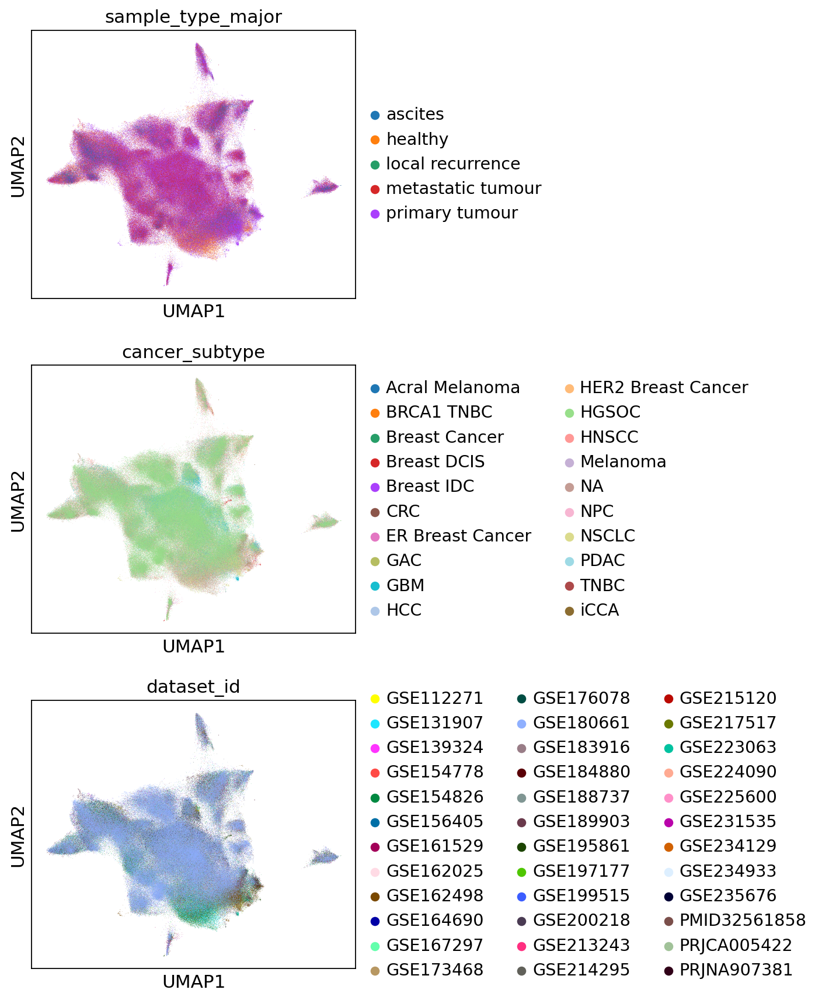

In [ ]:
#visualise UMAP --> can see now integrated
sc.pl.umap(
    data,
    color=[
        "sample_type_major",
        "cancer_subtype",
        "dataset_id",
    ],
    ncols=1,
)

In [ ]:
data

AnnData object with n_obs × n_vars = 529241 × 1295
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'sample_type_major_colors', 'cancer_subtype_colors', 'dataset_id_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 